In [1]:
import sys

sys.path
sys.executable

'/Users/nandinisahu/opt/anaconda3/envs/py3/bin/python'

In [2]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.axes_grid1 import make_axes_locatable
%matplotlib inline
import lenstronomy.Util.util as util
import lenstronomy.Util.image_util as image_util
from lenstronomy.Util import param_util
from lenstronomy.Util import mask_util
from lenstronomy.Util.util import array2image
from lenstronomy.ImSim.image_model import ImageModel
from lenstronomy.PointSource.point_source import PointSource
from lenstronomy.LensModel.lens_model import LensModel
from lenstronomy.LensModel.Solver.lens_equation_solver import LensEquationSolver
from lenstronomy.LightModel.light_model import LightModel
from lenstronomy.Sampling.parameters import Param
from lenstronomy.Data.imaging_data import ImageData
from lenstronomy.Data.psf import PSF
import numpy as np
import os
import pickle
import copy
import time
import h5py
from pprint import pprint
import joblib
from astropy.cosmology import FlatLambdaCDM
from lenstronomy.Data.coord_transforms import Coordinates
from lenstronomy.Workflow.fitting_sequence import FittingSequence
from lenstronomy.Data.pixel_grid import PixelGrid
from lenstronomy.Plots import  plot_util

cwd = os.getcwd()
base_path = cwd
print('Base directory path:', base_path)

Base directory path: /Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/compound_lens/compound_lens_dcls1507-NS-main/notebooks


In [3]:
import lenstronomy
lenstronomy.__version__

'1.12.3'

In [4]:
import matplotlib as mpl

# for MNRAS
mpl.rcParams['ps.fonttype'] = 42

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid, make_axes_locatable
import matplotlib.image as mpimg
import seaborn as sns
import coloripy as cp

# to change tex to Times New Roman in mpl
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['mathtext.rm'] = 'serif'
plt.rcParams['mathtext.it'] = 'serif:italic'
plt.rcParams['mathtext.bf'] = 'serif:bold'
plt.rcParams['mathtext.fontset'] = 'custom'

sns.set(style='ticks', context='paper', font='Times New Roman', font_scale=2.)
#sns.set_context('talk')
sns.set_style({"xtick.direction": "in","ytick.direction": "in", "axes.linewidth": 2.0,})
#sns.set_palette('Set2')

cmap = sns.cubehelix_palette(start=0.5, rot=-1.5, gamma=1, hue=1, light=-.6, dark=0.8, reverse=False, as_cmap=True)
cmap2 = sns.cubehelix_palette(start=0.5, rot=-1.5, gamma=1, hue=1, light=-.2, dark=1., reverse=False, as_cmap=True)

msh_cmap = cp.get_msh_cmap(num_bins=501, rescale='power', power=2.5)

/Users/nandinisahu/opt/anaconda3/envs/py3/lib/python3.10/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [6]:
import h5py

def import_data(filter_name):
    
    data_file = os.path.join('../data/image_DCLS1507+0522_{}.h5'.format(filter_name))
    f = h5py.File(data_file, 'r')
    
    kwargs_data = {}
    for key in f:
        kwargs_data[key] = f[key][()]
    f.close()

    # get data and PSF estimate from file
    psf_file = os.path.join('../PSF files/psf_model_{}.h5'.format(filter_name))
    f = h5py.File(psf_file, 'r')
    kernel_point_source = f['kernel_point_source'][()]
    # psf_error_map = f['psf_error_map'][()]
    f.close()


    kwargs_psf = {'psf_type': "PIXEL", 
                'kernel_point_source': kernel_point_source ,
                'kernel_point_source_init': kernel_point_source ,
                #    'psf_error_map': psf_error_map,
                }

    return kwargs_data, kwargs_psf

kwargs_data_F200LP, kwargs_psf_F200LP = import_data('F200LP')
kwargs_data_F140W, kwargs_psf_F140W = import_data('F140W')

kwargs_data_F140W['ra_shift'] = kwargs_data_F140W['ra_shift'] - kwargs_data_F200LP['ra_shift']
kwargs_data_F140W['dec_shift'] = kwargs_data_F140W['dec_shift'] - kwargs_data_F200LP['dec_shift']

kwargs_data_F200LP['ra_shift'] = 0
kwargs_data_F200LP['dec_shift'] = 0

In [7]:
kwargs_data_F140W

{'background_rms': 0.02259360440075,
 'dec_at_xy_0': -7.034488715086257,
 'dec_shift': 0.012699999999999934,
 'exposure_time': array([[219.1675 , 208.12521, 217.50636, ..., 202.67644, 227.30098,
         240.72963],
        [268.05038, 216.44777, 281.9542 , ..., 223.26054, 223.02518,
         235.99332],
        [251.9576 , 203.57751, 280.07587, ..., 215.60355, 254.16888,
         269.4963 ],
        ...,
        [239.1487 , 266.9713 , 209.9095 , ..., 202.46257,  95.80747,
         219.91754],
        [216.88469, 246.2649 , 183.09084, ..., 192.94171,  98.44137,
         221.15611],
        [222.99677, 243.6608 , 192.39893, ..., 183.53331,  91.49941,
         206.21883]], dtype=float32),
 'image_data': array([[ 2.2908628e-02,  2.1038681e-02, -5.4276586e-03, ...,
         -1.0041654e-02, -9.0478063e-03, -2.0102471e-02],
        [ 2.6980639e-03,  4.8935413e-05, -3.0648381e-02, ...,
          2.7212024e-02, -4.2562425e-02, -5.7859570e-02],
        [ 2.7310282e-02,  1.3994843e-02, -4.013538

Pixel size: 0.05 arcsec
numPix: 240
********************
Lens center: -0.8395023773705237 -0.48224204139963334
********************
Galaxy 1 center: -0.40495199683448746 1.152141851292571
Galaxy 2 center: -0.7259344298101684 -1.9257777388153974
********************
Source 1 center: -0.9946517084153268 1.141853220018103
********************
Image S1 center 0: -0.7259344298101684, -1.9257777388153974
Image S1 center 1: 1.077677899407675, 4.24811644599183
Image S1 center 2: -1.3107344591144519, 4.338782346204262
Image S1 center 3: -3.6282050419045113, 3.5019453591584284
********************
********************
Source 2 center: 0.6167336450339843 -0.20958171313143767
********************
Image S2 center 0: 4.684474513668903, 0.5062295049084398
Image S2 center 1: -2.0350943517481808, -2.422953578967986
Image S2 center 2: -3.488116480968383, -0.9227397283898604
Image S2 center 3: -2.239525403868929, 1.1434651690498185
********************


/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/1315279739.py:22: RuntimeWarning: invalid value encountered in log10
  ax.matshow(np.log10(data_cutout), origin='lower', cmap=cmap, vmin=-6, vmax=1.0) #v_min=-3,v_max= -0.2


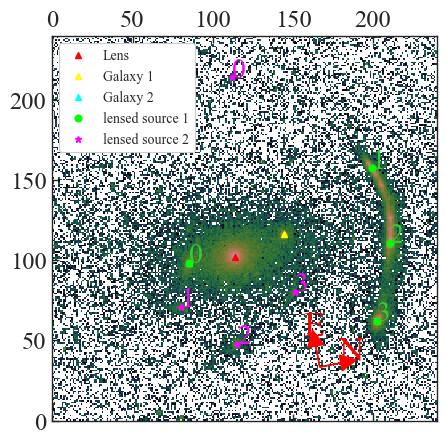

In [8]:
# %matplotlib ipympl
%matplotlib inline

# read-in the coordiante system of the exposure
ra_at_xy_0 = kwargs_data_F200LP['ra_at_xy_0']
dec_at_xy_0 = kwargs_data_F200LP['dec_at_xy_0']
transform_pix2angle = kwargs_data_F200LP['transform_pix2angle']
coords_F200LP = Coordinates(transform_pix2angle, ra_at_xy_0, dec_at_xy_0)


# read-in the reduced cutout image
data_cutout = kwargs_data_F200LP['image_data']
numPix = len(data_cutout)
deltaPix = coords_F200LP.pixel_width
print('Pixel size: {:.2f} arcsec'.format(deltaPix))
print('numPix:', numPix)
# print('transform_pix2angle:', transform_pix2angle)

print('*'*20)

ax = plt.figure(figsize=(5, 5)).add_subplot(111)
ax.matshow(np.log10(data_cutout), origin='lower', cmap=cmap, vmin=-6, vmax=1.0) #v_min=-3,v_max= -0.2
ax.autoscale(False)

kwargs_pixel = {'nx': numPix, 'ny': numPix,  # number of pixels per axis
                'ra_at_xy_0': ra_at_xy_0,  # RA at pixel (0,0)
                'dec_at_xy_0': dec_at_xy_0,  # DEC at pixel (0,0)
                'transform_pix2angle': transform_pix2angle} 

pixel_grid = PixelGrid(**kwargs_pixel)
plot_util.coordinate_arrows(ax, d=200, coords=pixel_grid, color='red', font_size=25, arrow_size=0.05)

lens_x_F200LP, lens_y_F200LP =113.73636, 101.67792  #113, 102   114.66136, 102.96184
lens_ra_F200LP, lens_dec_F200LP = coords_F200LP.map_pix2coord(lens_x_F200LP, lens_y_F200LP)
ax.plot(lens_x_F200LP, lens_y_F200LP, '^', color='red', label='Lens') 
print('Lens center:', lens_ra_F200LP, lens_dec_F200LP) 

print('*'*20)

gal1_x_F200LP, gal1_y_F200LP =144.16586, 116.44726 #144, 116   145.16586, 116.94726
gal1_ra_F200LP, gal1_dec_F200LP = coords_F200LP.map_pix2coord(gal1_x_F200LP, gal1_y_F200LP)
ax.plot(gal1_x_F200LP, gal1_y_F200LP, '^', color='yellow', label='Galaxy 1') 
print('Galaxy 1 center:', gal1_ra_F200LP, gal1_dec_F200LP)

gal2_x_F200LP, gal2_y_F200LP =84.9617, 98.3979 #144, 116   145.16586, 116.94726
gal2_ra_F200LP, gal2_dec_F200LP = coords_F200LP.map_pix2coord(gal2_x_F200LP, gal2_y_F200LP )
ax.plot(gal2_x_F200LP, gal2_y_F200LP, '^', color='cyan', label='Galaxy 2') 
print('Galaxy 2 center:', gal2_ra_F200LP, gal2_dec_F200LP)

print('*'*20)
#s1_x_img_pos,s1_y_img_pos =159.49841980975322, 86.19625327873504 # not final
#s1_x, s1_y =coords.map_pix2coord(s1_x_img_pos,s1_y_img_pos)
s1_x, s1_y=-0.9946517084153268, 1.141853220018103
s1_x_img_pos,s1_y_img_pos = coords_F200LP.map_coord2pix(s1_x, s1_y )
#ax.plot(s1_x_img_pos, s1_y_img_pos, '^', color='lime',markersize=10, label='Source 1')
print('Source 1 center:', s1_x, s1_y)
print('*'*20)

# estimate point source positions in pixel
im_pos_x = np.array([ 84.9617, 199.2906, 210.1870, 202.6028]) #84.9617,
im_pos_y = np.array([ 98.3979,157.3715, 110.8272, 62.1356]) #98.3979,

ra_image, dec_image = coords_F200LP.map_pix2coord(im_pos_x, im_pos_y)
ax.plot(im_pos_x, im_pos_y, 'o', color='lime',label='lensed source 1')

ra_image_1, dec_image_1 = copy.deepcopy(ra_image), copy.deepcopy(dec_image)

for i in range(len(im_pos_x)):
    ax.text(im_pos_x[i], im_pos_y[i], i, fontsize=20, color='limegreen')
    print('Image S1 center {}: {}, {}'.format(i, ra_image[i], dec_image[i]))

print('*'*20)
print('*'*20)

#s2_x_img_pos,s2_y_img_pos = 113.8880243857698, 129.71950917762942 # not final
#s2_x, s2_y =coords.map_pix2coord(s2_x_img_pos,s2_y_img_pos)
s2_x, s2_y= 0.6167336450339843, -0.20958171313143767
s2_x_img_pos,s2_y_img_pos = coords_F200LP.map_coord2pix( s2_x, s2_y)
#ax.plot(s2_x_img_pos,s2_y_img_pos, '^', color='magenta', label='Source 2',markersize=10)
print('Source 2 center:', s2_x, s2_y)
print('*'*20)

im_pos_x_s2=([112.0587, 80.1975, 115.1975, 150.9979 ])
im_pos_y_s2=([213.8998, 70.7983, 47.9979, 80.3970 ])

ra_image_s2, dec_image_s2 = coords_F200LP.map_pix2coord(im_pos_x_s2, im_pos_y_s2)
ax.plot(im_pos_x_s2, im_pos_y_s2, '*', color='magenta',label='lensed source 2')

ra_image_2, dec_image_2 = copy.deepcopy(ra_image_s2), copy.deepcopy(dec_image_s2)

for i in range(len(ra_image_2)):
    ax.text(im_pos_x_s2[i], im_pos_y_s2[i], i, fontsize=20, color='magenta')
    print('Image S2 center {}: {}, {}'.format(i, ra_image_s2[i], dec_image_s2[i]))

print('*'*20)

#print(coords.map_pix2coord(115.198,  47.998))

plt.legend(loc='upper left', fontsize=10, framealpha=1)
#plt.savefig(fname='DSPL1507.pdf', format='pdf')
plt.show()

Pixel size: 0.08 arcsec
numPix: 150
********************
********************
Lens center: -0.8294023773705237 -0.4695420413996334
Gal1 center: -0.39485199683448746 1.164841851292571
Gal2 center: -0.72 -1.91
********************
Source 1 center: -0.9946517084153268 1.141853220018103
********************
Image S1 center 0: -0.7158344298101684, -1.9130777388153974
Image S1 center 1: 1.087777899407675, 4.260816445991829
Image S1 center 2: -1.3006344591144519, 4.3514823462042616
Image S1 center 3: -3.6181050419045113, 3.514645359158428
pixel coordinates: [ 53.2326691  124.68862561 131.49864463 126.75826298], [61.653094   98.51099973 69.42075798 38.98854946] 

********************
Image S2 center 0: 4.694574513668902, 0.5189295049084397
Image S2 center 1: -2.0249943517481808, -2.4102535789679864
Image S2 center 2: -3.478016480968383, -0.9100397283898605
Image S2 center 3: -2.229425403868929, 1.1561651690498185
pixel coordinates: [70.16891011 50.25489826 72.12980857 94.50525367], [133.841635

/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/1481115202.py:20: RuntimeWarning: invalid value encountered in log10
  ax.matshow(np.log10(data_cutout), origin='lower', cmap=cmap, vmin=-2, vmax=0.2) #v_min=-3,v_max= -0.2


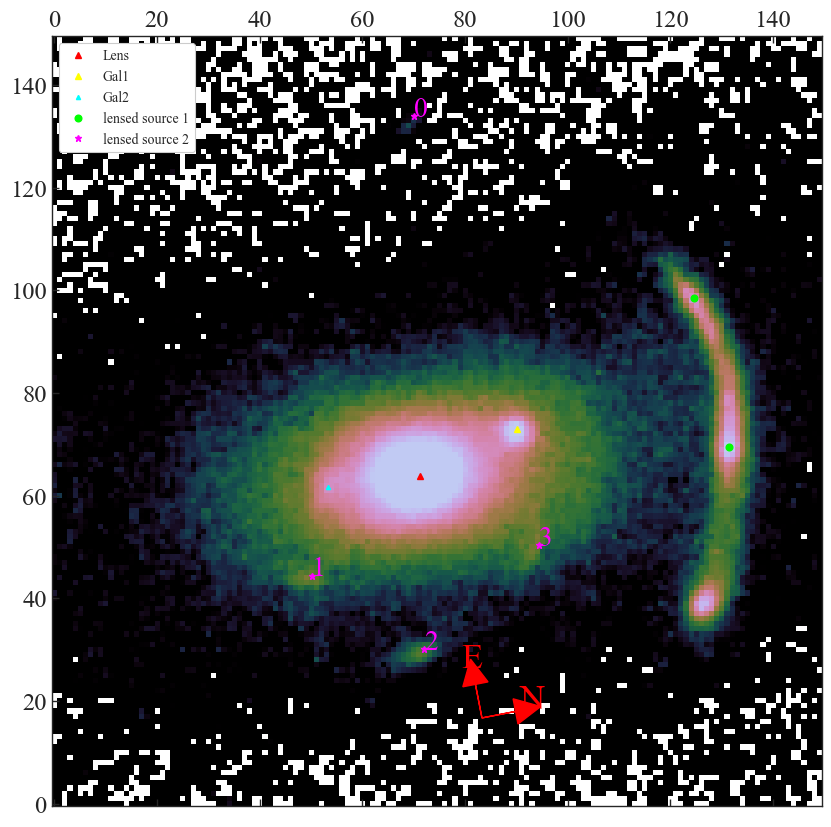

In [9]:
# %matplotlib ipympl
%matplotlib inline

# read-in the coordiante system of the exposure
ra_at_xy_0 = kwargs_data_F140W['ra_at_xy_0']
dec_at_xy_0 = kwargs_data_F140W['dec_at_xy_0']
transform_pix2angle = kwargs_data_F140W['transform_pix2angle']
coords_F140W = Coordinates(transform_pix2angle, ra_at_xy_0, dec_at_xy_0)

# read-in the reduced cutout image
data_cutout = kwargs_data_F140W['image_data']
numPix = len(data_cutout)
deltaPix = coords_F140W.pixel_width
print('Pixel size: {:.2f} arcsec'.format(deltaPix))
print('numPix:', numPix)
# print('transform_pix2angle:', transform_pix2angle)
print('*'*20)

ax = plt.figure(figsize=(10, 10)).add_subplot(111)
ax.matshow(np.log10(data_cutout), origin='lower', cmap=cmap, vmin=-2, vmax=0.2) #v_min=-3,v_max= -0.2
ax.autoscale(False)

kwargs_pixel = {'nx': numPix, 'ny': numPix,  # number of pixels per axis
                'ra_at_xy_0': ra_at_xy_0,  # RA at pixel (0,0)
                'dec_at_xy_0': dec_at_xy_0,  # DEC at pixel (0,0)
                'transform_pix2angle': transform_pix2angle} 

pixel_grid = PixelGrid(**kwargs_pixel)
plot_util.coordinate_arrows(ax, d=100, coords=pixel_grid, color='red', font_size=25, arrow_size=0.05)

print('*'*20)
lens_ra_F140W, lens_dec_F140W=lens_ra_F200LP+kwargs_data_F140W['ra_shift'], lens_dec_F200LP+kwargs_data_F140W['dec_shift']
lens_x_F140W,lens_y_F140W=coords_F140W.map_coord2pix(lens_ra_F140W, lens_dec_F140W)
ax.plot(lens_x_F140W,lens_y_F140W, '^', color='red', label='Lens') 
print('Lens center:', lens_ra_F140W, lens_dec_F140W) 

gal1_ra_F140W, gal1_dec_F140W=gal1_ra_F200LP+kwargs_data_F140W['ra_shift'], gal1_dec_F200LP+kwargs_data_F140W['dec_shift']
gal1_x_F140W,gal1_y_F140W=coords_F140W.map_coord2pix(gal1_ra_F140W, gal1_dec_F140W)
ax.plot(gal1_x_F140W,gal1_y_F140W, '^', color='yellow', label='Gal1') 
print('Gal1 center:', gal1_ra_F140W, gal1_dec_F140W) 

gal2_ra_F140W, gal2_dec_F140W=-0.72, -1.91
#gal2_ra_F200LP+kwargs_data_F140W['ra_shift'], gal2_dec_F200LP+kwargs_data_F140W['dec_shift']
gal2_x_F140W,gal2_y_F140W=coords_F140W.map_coord2pix(gal2_ra_F140W, gal2_dec_F140W)
ax.plot(gal2_x_F140W,gal2_y_F140W, '^',markersize=3, color='cyan', label='Gal2') 
print('Gal2 center:', gal2_ra_F140W, gal2_dec_F140W) 

print('*'*20)

s1_x, s1_y=-0.9946517084153268, 1.141853220018103
s1_x_img_pos,s1_y_img_pos = coords_F200LP.map_coord2pix(s1_x, s1_y )
#ax.plot(s1_x_img_pos, s1_y_img_pos, '^', color='lime',markersize=10, label='Source 1')
print('Source 1 center:', s1_x, s1_y)


print('*'*20)


im_pos_ra_F140W, im_pos_dec_F140W=ra_image+kwargs_data_F140W['ra_shift'], dec_image+kwargs_data_F140W['dec_shift']
im_pos_x_F140W, im_pos_y_F140W=coords_F140W.map_coord2pix(im_pos_ra_F140W, im_pos_dec_F140W)
ax.plot(im_pos_x_F140W[1:3], im_pos_y_F140W[1:3], 'o', color='lime',label='lensed source 1') #markersize=2,
for i in range(len(im_pos_x_F140W)):
    #ax.text(im_pos_x_F140W[i], im_pos_y_F140W[i], i, fontsize=20, color='limegreen')
    print('Image S1 center {}: {}, {}'.format(i, im_pos_ra_F140W[i], im_pos_dec_F140W[i]))

print('pixel coordinates: {}, {} \n'.format(im_pos_x_F140W, im_pos_y_F140W ))

print('*'*20)


im2_pos_ra_F140W, im2_pos_dec_F140W=ra_image_s2+kwargs_data_F140W['ra_shift'], dec_image_s2+kwargs_data_F140W['dec_shift']
im2_pos_x_F140W, im2_pos_y_F140W=coords_F140W.map_coord2pix(im2_pos_ra_F140W, im2_pos_dec_F140W)
ax.plot(im2_pos_x_F140W, im2_pos_y_F140W, '*', color='magenta',label='lensed source 2')

for i in range(len(im2_pos_ra_F140W)):
    ax.text(im2_pos_x_F140W[i], im2_pos_y_F140W[i], i, fontsize=20, color='magenta')
    print('Image S2 center {}: {}, {}'.format(i, im2_pos_ra_F140W[i], im2_pos_dec_F140W[i]))

print('pixel coordinates: {}, {} \n'.format(im2_pos_x_F140W, im2_pos_y_F140W))

print('*'*20)

plt.legend(loc='upper left', fontsize=10, framealpha=1)
#plt.savefig(fname='DSPL1507.pdf', format='pdf')
plt.show()

Pixel size: 0.08 arcsec


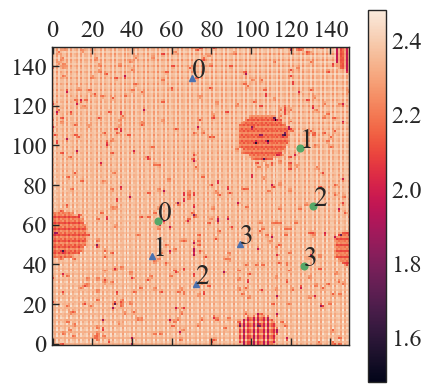

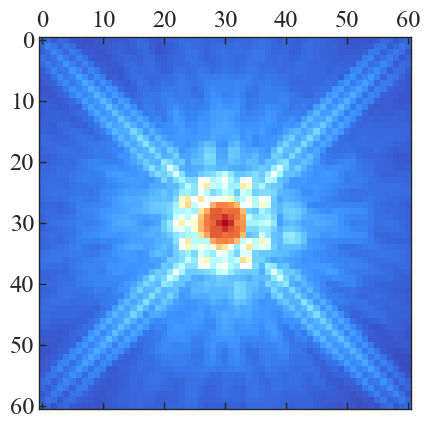

In [11]:
#plot exposure map and PSF
%matplotlib inline 

#coords=coords_F200LP
#coords=coords_F140W

deltaPix = coords_F140W.pixel_width
print('Pixel size: {:.2f} arcsec'.format(deltaPix))
x_coords, y_coords = coords_F140W.coordinate_grid(numPix, numPix)
#wht_map = kwargs_data_F140W['exposure_time']
wht_map = kwargs_data_F140W['exposure_time']

plt.matshow(np.log10(wht_map), origin='lower')
plt.autoscale(False)

plt.plot(im_pos_x_F140W, im_pos_y_F140W,'og')
plt.plot(im2_pos_x_F140W, im2_pos_y_F140W,'^b')

for i in range(len(im_pos_x)):
    plt.text(im_pos_x_F140W[i], im_pos_y_F140W[i], i, fontsize=20)
    plt.text(im2_pos_x_F140W[i], im2_pos_y_F140W[i], i, fontsize=20)
plt.colorbar()
plt.show()


#psf_kernel = kwargs_psf_F140W['kernel_point_source']
psf_kernel = kwargs_psf_F140W['kernel_point_source']
plt.matshow(np.log10(psf_kernel), vmin=-6, cmap=msh_cmap)
plt.show()

/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/371733419.py:55: RuntimeWarning: divide by zero encountered in log10
  im = ax.matshow(np.log10(image*mask), origin='lower', cmap=cmap, vmax=1, vmin=-3.5)
/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/371733419.py:55: RuntimeWarning: invalid value encountered in log10
  im = ax.matshow(np.log10(image*mask), origin='lower', cmap=cmap, vmax=1, vmin=-3.5)
/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/371733419.py:63: RuntimeWarning: invalid value encountered in log10
  im = ax.matshow(np.log10(image), origin='lower', cmap=cmap, vmax=1, vmin=-3.5)


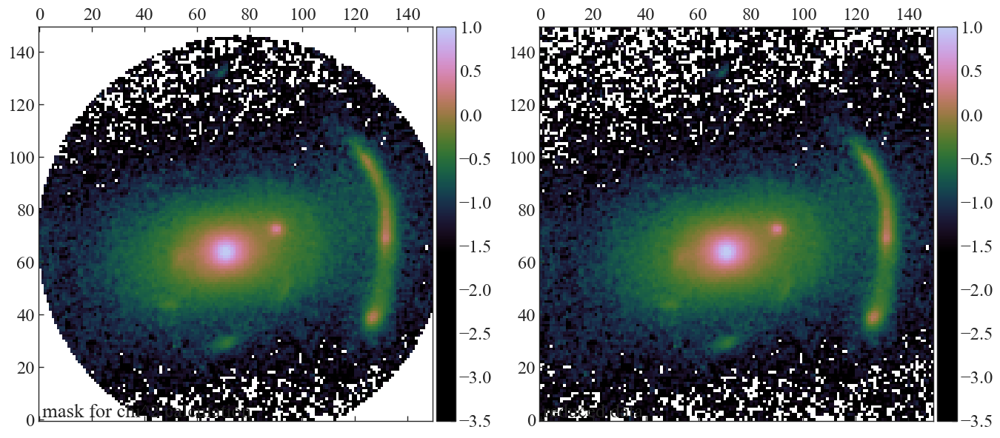

In [12]:
central_mask = True
central_mask_r =0 #0.24 #0.24

#radius of circular aperture to consider 
r_mask_list = [[6.2]
              ]

mask_list = []
index_mask_list = []

for i in range(len(r_mask_list[0])):
    mask_bands = []
    index_mask_bands = []

    for j, kwargs_data in enumerate([kwargs_data_F140W]):
        ra_at_xy_0 = kwargs_data['ra_at_xy_0']
        dec_at_xy_0 = kwargs_data['dec_at_xy_0']
        transform_pix2angle = kwargs_data['transform_pix2angle']
        coords = Coordinates(transform_pix2angle, ra_at_xy_0, dec_at_xy_0)
        num_pix = len(kwargs_data['image_data'])
        lens_center_ra = lens_ra_F140W
        lens_center_dec = lens_dec_F140W

        x_coords, y_coords = coords.coordinate_grid(num_pix, num_pix)
        r = r_mask_list[j][i]
        mask_outer = mask_util.mask_center_2d(lens_center_ra+0.3, lens_center_dec+0.5, r, util.image2array(x_coords), util.image2array(y_coords))
        index_mask = 1 - mask_util.mask_center_2d(lens_center_ra, lens_center_dec, r, util.image2array(x_coords), util.image2array(y_coords))
        corona = mask_util.mask_center_2d(lens_center_ra, lens_center_dec, central_mask_r, util.image2array(x_coords), util.image2array(y_coords))
 
        mask = (1 - mask_outer) # now modeling both sources

        if central_mask:
            mask *= corona
        
        # mask = 1 - mask_outer

        mask[mask >= 1] = 1
        mask[mask < 0] = 0
        
        mask_bands.append(array2image(mask))
        index_mask_bands.append(index_mask)
        
    mask_list.append(mask_bands)
    index_mask_list.append(index_mask_bands)
    
for j, kwargs_data in enumerate([kwargs_data_F140W]):
    image = kwargs_data['image_data']
    
    f, axes = plt.subplots(1, len(r_mask_list[0])+1, figsize=(16, 8), sharex=False, sharey=False)
    for i in range(len(r_mask_list[0])):
        ax = axes[i]
        
        mask = mask_list[0][j]
        
        im = ax.matshow(np.log10(image*mask), origin='lower', cmap=cmap, vmax=1, vmin=-3.5)
        ax.text(1, 1, 'mask for chi^2 calculation')
        ax.autoscale(False)
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

        ax = axes[i+1]
        im = ax.matshow(np.log10(image), origin='lower', cmap=cmap, vmax=1, vmin=-3.5)
        ax.text(1, 1, 'reduced data')
        ax.autoscale(False)
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

        plt.show()

/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/1866632064.py:24: RuntimeWarning: divide by zero encountered in log10
  im = ax.matshow(np.log10(image*mask), origin='lower')


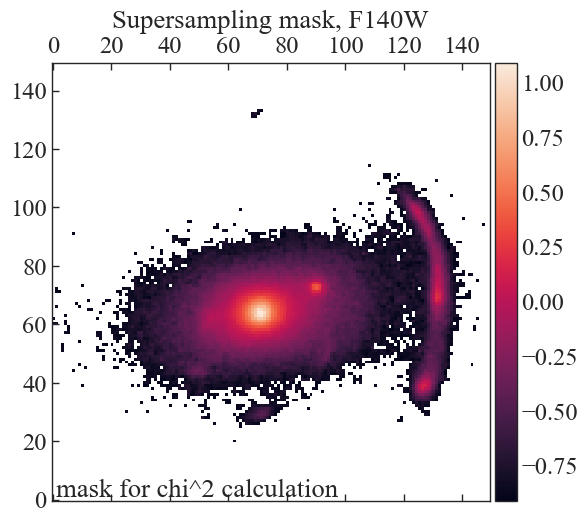

In [13]:
threshold = 10**(5/2.5) 
# pixels with flux > max_flux/threshold will not be supersampled
# here the threshold accepts pixels within 5 magnitude from the pixel with max_flux

supersampling_mask = []

for j, kwargs_data in enumerate([kwargs_data_F140W]):
    s_mask = np.ones_like(kwargs_data['image_data'])
    
    max_flux = np.max(kwargs_data['image_data'])
    s_mask[kwargs_data['image_data'] < max_flux/threshold] = 0
    
    supersampling_mask.append(s_mask)

filters = ['F140W']

for j, kwargs_data in enumerate([kwargs_data_F140W]):
    image = kwargs_data['image_data']
    
    fig = plt.figure(figsize=(6,6))
    ax = fig.add_subplot(111)

    mask = supersampling_mask[j]*mask_list[0][j]
    im = ax.matshow(np.log10(image*mask), origin='lower')
    ax.text(1, 1, 'mask for chi^2 calculation')
    ax.autoscale(False)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    ax.set_title("Supersampling mask, "+filters[j])
    plt.colorbar(im, cax=cax)

    plt.show()

In [15]:
from astropy.cosmology import FlatLambdaCDM, wCDM
import astropy.units as u

cosmo = FlatLambdaCDM(H0=70 * u.km / u.s / u.Mpc, Om0=0.3, Ob0=0.05)

#z_lens = 0.594
# Dominique and Lise claim 2.27 for the qso and 2.35 for the other blob.
#z_source_1 = 2.164
#z_source_2 = 2.6

z_l = 0.594
z_s1 = 2.163
z_s2 = 2.591

D_l=cosmo.angular_diameter_distance(z_l).value
D_s1 = cosmo.angular_diameter_distance(z_s1).value
D_s2 = cosmo.angular_diameter_distance(z_s2).value
D_ls1 = cosmo.angular_diameter_distance_z1z2(z_l, z_s1).value
D_ls2 = cosmo.angular_diameter_distance_z1z2(z_l, z_s2).value

#cosmological scaling factor=deflection_scaling= 1/β
deflection_scaling = D_s1 / D_ls1 * D_ls2 / D_s2  
beta=1/deflection_scaling
print('Deflection angle rescale factor: {:.6f}'.format(deflection_scaling))
print('Beta12:{:.6f}'.format(beta))

Deflection angle rescale factor: 1.060133
Beta12:0.943278


In [16]:
from numpy import True_


ssh_command = 'nsahu@mpa'
dir_path = os.getcwd()
dir_path_cluster = '/afs/mpa/temp/nsahu/dcls1507'


# numeric settings
band_number = 1 # 3

n_p_short = 100 # number of particles in the PSO (for tests)
n_i_short = 100 # number of iterations of the PSO (for tests)
n_p_medium = 48
n_i_medium = 100
n_p_long = 248  # number of particles in the PSO
n_i_long = 250  # number of iterations of the PSO

mcmc_n_burn = 1
mcmc_repeat = 2
mcmc_n_run = 2000 # the MCMC is performed in broken chunks, the next chunk is resumed from the last, final run >2000
walker_ratio = 8

psf_iteration = False  # bool, we perform an iterative PSF reconstruction
psf_iter_num = 50  # number of steps in the PSF reconstruction
psf_iter_factor = 0.5  # factor of f*new + (1-f)*old PSF in each iterative step
psf_symmetry = 4  # number of symmetry axis rotations

# lens model settings

# lens light settings
#power_law_lens_light_list = [['SERSIC_ELLIPSE', 'SERSIC'],  ['SERSIC_ELLIPSE', 'SERSIC']] # band 2

lens_center_ra, lens_center_dec = lens_ra_F140W, lens_dec_F140W
#lens_eqn_ra, lens_eqn_dec = -0.9939583274126432,-0.43171016592210615 #from position model
lens_bound = 0.16 #2. # bound for lens position from the initial position

gal1_center_x, gal1_center_y = gal1_ra_F140W, gal1_dec_F140W
#gal1_eqn_ra,gal1_eqn_dec= -0.389,1.205  #coords.map_pix2coord(145.14274578762178, 116.96218362962559) #from position model
gal_bound = 0.08

gal2_center_x, gal2_center_y =gal2_ra_F140W, gal2_dec_F140W
gal2_bound=0.08

# source settings
#source_light_model_list_template = ['SERSIC_ELLIPSE'] # 'SERSIC_ELLIPSE' or 'SERSIC'; don't need to add shapelets as it's added inside the function
#with_shapelets = True
shapelet_beta = 0.15 # initial guess of the shapelet scale (in arcsec)

source_x, source_y = -1.1036461067018895, 2.360725499690687 #from position model 
image_x, image_y =-1.3006344591144519, 4.3514823462042616 #highest mag image (image 2 of source1)
source_bound = 0.15 #0.15

source2_x, source2_y = 0.4736737826214802, 0.0010778829027697375 # previous model
image2_x, image2_y = -3.478016480968383, -0.9100397283898605 #highest mag image (image 2 of source2)


#is_image_plane1 = False  #whether or not I am using image plane coordinate for its centre(?)
#is_image_plane2 = True   #True

# point source settings
#point_source_model_list = []  # we model the point sources in the image plane



In [17]:
lens_redshift_list= [z_l, z_l, z_l, z_s1, z_l, z_l]
lens_model_list = ['NFW_ELLIPSE_CSE', 'SHEAR_GAMMA_PSI', 'SIS', 'EPL','DOUBLE_CHAMELEON','SIE'] #,'SIE'
lensModel_mp = LensModel(lens_model_list=lens_model_list, z_source=z_s2, lens_redshift_list=lens_redshift_list, multi_plane=True) #lens_model_list_simple[:2] for slicing
#solver4Point_mp = Solver4Point(lensModel=lensModel_mp, solver_type='PROFILE_SHEAR') #PROFILE_SHEAR PROFILE

kwargs_lens_init =[
{'Rs': 28.378185352485225,
  'alpha_Rs': 6.760516877075251,
  'e1': -0.36277991250896674,
  'e2': -0.04908794505640055,
  'center_x': -0.7998459992509643,
  'center_y': -0.48203274877369734},
 {'gamma_ext': 0.09750882354180022,
  'psi_ext': 1.4717522734886967,
  'ra_0': 0,
  'dec_0': 0},
 {'theta_E': 0.1333944669073478,
  'center_x': -0.4107853720148221,
  'center_y': 1.142058874184596},
 {'theta_E': 0.06603274500396837,
  'gamma': 2,
  'e1': 0.021097739586927285,
  'e2': -0.3094765223631876,
  'center_x': -1.0636138056152182,
  'center_y': 1.0671312983394878},
 {'alpha_1': 0.4017348639081723,
  'ratio': 0.9898756545476914,
  'w_c1': 0.07606501251917679,
  'w_t1': 0.3503546630055888,
  'e11': -0.03828606850996896,
  'e21': -0.016414123702239398,
  'w_c2': 0.3444015424969858,
  'w_t2': 2.963442854859148,
  'e12': -0.3616256326985836,
  'e22': -0.01718547191000611,
  'center_x': -0.7998459992509643,
  'center_y': -0.48203274877369734},
 {'theta_E': 0.10639803832271554,
  'e1': 0.4867997936669468,
  'e2': 0.2433233283607018,
  'center_x': -0.7214306606349824,
  'center_y': -1.875834219077375}
                  ]
                    

kwargs_lens_sigma = [{'Rs': 0.2, 'alpha_Rs': 0.2,  'e1': 0.2, 'e2': .2, 'center_x': 0.01, 'center_y': 0.01},
                    {'gamma_ext': 0.1, 'psi_ext': 0.1}, 
                     {'theta_E': 0.1, 'center_x': 0.01, 'center_y':0.01},
                     {'theta_E': 0.1, 'gamma': 0.01, 'e1': 0.2, 'e2': 0.2, 'center_x': 0.1, 'center_y': 0.1}, # 
                     {'alpha_1':0.2},
                    {'theta_E': 0.1,'e1': 0.2, 'e2': 0.2, 'center_x': 0.01, 'center_y':0.01}
                    ]

kwargs_lower_lens=[{'Rs': 0,'alpha_Rs': 0, 'e1': -0.5,'e2': -0.5,'center_x': -10,'center_y': -10},
                  {'gamma_ext': 0.00, 'psi_ext': -np.pi},
                   {'theta_E': 0, 'center_x': -10,'center_y': -10},
                  {'theta_E': 0.0, 'gamma': 1.5,'e1': -0.5, 'e2': -0.5,  'center_x': -10., 'center_y': -10}, #
                   {'alpha_1':0.0},
                  {'theta_E': 0, 'e1': -0.5, 'e2': -0.5,'center_x': -10,'center_y': -10}
                  ]

kwargs_upper_lens=[{'Rs': 100, 'alpha_Rs': 10,'e1': 0.5,'e2': 0.5,'center_x': 10, 'center_y': 10},
                  {'gamma_ext': 0.3, 'psi_ext': np.pi},
                  {'theta_E': 1, 'center_x': 10, 'center_y': 10},
                  {'theta_E': 1, 'gamma': 2.5,'e1': 0.5, 'e2': 0.5, 'center_x': 10., 'center_y': 10}, # 
                   {'alpha_1':10},
                 {'theta_E': 1,'e1': 0.5, 'e2': 0.5, 'center_x': 10, 'center_y': 10}
                  ]


kwargs_lens_fixed=[{},{'ra_0': 0, 'dec_0': 0},{},{'gamma': 2},{},{}] #'gamma': 2

lens_params = [kwargs_lens_init, kwargs_lens_sigma, kwargs_lens_fixed, kwargs_lower_lens, kwargs_upper_lens]

In [18]:
#lens_light_model_list= ['SERSIC_ELLIPSE', 'SERSIC', 'SERSIC_ELLIPSE']
lens_light_model_list= [ 'DOUBLE_CHAMELEON','SERSIC','SERSIC_ELLIPSE']

kwargs_lens_light_init=[{
  'ratio': 0.9898756545476914,
  'w_c1': 0.07606501251917679,
  'w_t1': 0.3503546630055888,
  'e11': -0.03828606850996896,
  'e21': -0.016414123702239398,
  'w_c2': 0.3444015424969858,
  'w_t2': 2.963442854859148,
  'e12': -0.3616256326985836,
  'e22': -0.01718547191000611,
  'center_x': -0.7998459992509643,
  'center_y': -0.48203274877369734},
 {
  'R_sersic': 0.3290114774128901,
  'n_sersic': 5.232176291972024,
  'center_x': -0.4107853720148221,
  'center_y': 1.142058874184596},
 {
  'R_sersic': 0.1380700499482012,
  'n_sersic': 1.0558937257697707,
  'e1': 0.4867997936669468,
  'e2': 0.2433233283607018,
  'center_x': -0.7214306606349824,
  'center_y': -1.875834219077375}
                       ]

kwargs_lens_light_sigma=[{'ratio':0.1, 'w_c1':0.2,'w_t1':0.2 ,'e11':0.2, 'e21':0.2,
                          'w_c2':0.2,'w_t2':0.2 ,'e12':0.2, 'e22':0.2, 'center_x':0.1,'center_y':0.1 },
                        {'R_sersic': 0.1,'n_sersic': 0.1, 'center_x': 0.1, 'center_y': 0.1},
                        {'R_sersic': 0.1,'n_sersic': 0.2, 'e1': 0.1, 'e2': 0.1,'center_x': 0.1, 'center_y': 0.1}

                        ]

#kwargs_lens_light_sigma=[{ 'R_sersic': 0.05,'n_sersic': 0.15,  'e1': 0.1, 'e2': 0.1,'center_x': deltaPix/10., 'center_y': deltaPix/10.},
#                        {'R_sersic': 0.1,'n_sersic': 0.15, 'center_x': deltaPix/10., 'center_y': deltaPix/10.}]

kwargs_lower_lens_light=[{'ratio':0.0, 'w_c1':0.001,'w_t1':0.001 ,'e11':-0.5, 'e21':-0.5, 
                          'w_c2':0.001,'w_t2':0.001 ,'e12':-0.5, 'e22':-0.5,
                          'center_x':lens_center_ra -lens_bound,'center_y':lens_center_dec-lens_bound },                    
                        {'R_sersic': 0.01,'n_sersic': 0.1, 'center_x':gal1_center_x-gal_bound, 'center_y': gal1_center_y-gal_bound},
                        {'R_sersic': 0.001,'n_sersic': 0.4,  'e1': -0.5, 'e2': -0.5, 'center_x':gal2_center_x-gal2_bound, 'center_y':gal2_center_y-gal2_bound}
                        ]

kwargs_upper_lens_light=[{'ratio':10, 'w_c1':10,'w_t1':50 ,'e11':0.5, 'e21':0.5, 
                          'w_c2':10,'w_t2':50 ,'e12':0.5, 'e22':0.5, 
                          'center_x':lens_center_ra +lens_bound,'center_y':lens_center_dec+lens_bound },
                        {'R_sersic': 1,'n_sersic': 10, 'center_x':gal1_center_x+gal_bound, 'center_y': gal1_center_y+gal_bound},
                        {'R_sersic': 5,'n_sersic': 10,  'e1': 0.5, 'e2': 0.5,'center_x': gal2_center_x+gal2_bound, 'center_y': gal2_center_y+gal2_bound}
                       ]

kwargs_lens_light_fixed=[{'ratio': 0.9898756545476914, 'w_c1': 0.07606501251917679, 'w_t1': 0.3503546630055888,
                        'e11': -0.03828606850996896, 'e21': -0.016414123702239398, 
                        'w_c2': 0.3444015424969858, 'w_t2': 2.963442854859148, 
                         'e12': -0.3616256326985836, 'e22': -0.01718547191000611},{},{}]



lens_light_params = [kwargs_lens_light_init, kwargs_lens_light_sigma, kwargs_lens_light_fixed, kwargs_lower_lens_light, kwargs_upper_lens_light]


In [19]:
print(kwargs_upper_lens_light)
print(kwargs_lower_lens_light)

[{'ratio': 10, 'w_c1': 10, 'w_t1': 50, 'e11': 0.5, 'e21': 0.5, 'w_c2': 10, 'w_t2': 50, 'e12': 0.5, 'e22': 0.5, 'center_x': -0.6694023773705237, 'center_y': -0.30954204139963337}, {'R_sersic': 1, 'n_sersic': 10, 'center_x': -0.31485199683448745, 'center_y': 1.244841851292571}, {'R_sersic': 5, 'n_sersic': 10, 'e1': 0.5, 'e2': 0.5, 'center_x': -0.64, 'center_y': -1.8299999999999998}]
[{'ratio': 0.0, 'w_c1': 0.001, 'w_t1': 0.001, 'e11': -0.5, 'e21': -0.5, 'w_c2': 0.001, 'w_t2': 0.001, 'e12': -0.5, 'e22': -0.5, 'center_x': -0.9894023773705237, 'center_y': -0.6295420413996334}, {'R_sersic': 0.01, 'n_sersic': 0.1, 'center_x': -0.4748519968344875, 'center_y': 1.0848418512925708}, {'R_sersic': 0.001, 'n_sersic': 0.4, 'e1': -0.5, 'e2': -0.5, 'center_x': -0.7999999999999999, 'center_y': -1.99}]


In [20]:
source_model_list= ['SERSIC_ELLIPSE', 'SHAPELETS','SERSIC_ELLIPSE'] #'SHAPELETS',
image_plane_source_list=[False,False,False]
#image_plane_source_list=[True, True, True]
source_redshift_list=[z_s1,z_s1,z_s2]

kwargs_source_init=[
    {
  'R_sersic': 0.19017595244228672,
  'n_sersic': 2.4762422041235475,
  'e1': 0.021097739586927285,
  'e2': -0.3094765223631876,
  'center_x': -1.0636138056152182,
  'center_y': 1.0671312983394878},
 {
  'n_max': 8,
  'beta': 0.025928314426908346,
  'center_x': -1.0765381885788452,
  'center_y': 1.0203852889990748},
 {
  'R_sersic': 0.05594110009494071,
  'n_sersic': 0.49461167285249574,
  'e1': 0.07919059032436508,
  'e2': 0.3156156437962322,
  'center_x': -0.10538908688796511,
  'center_y': -0.30073807222262}
     ]

kwargs_source_sigma=[{'R_sersic': 0.2, 'n_sersic': 0.5,'e1':  0.2, 'e2': 0.2, 'center_x': 0.1, 'center_y': 0.1},
                    {'beta':0.001, 'center_x': 0.1, 'center_y': 0.1},
                 {'R_sersic': 0.2,  'n_sersic': 0.2,'e1': 0.2, 'e2': 0.2, 'center_x': 0.1, 'center_y': 0.1}] #

kwargs_lower_source=[{'R_sersic': 0.01, 'n_sersic': 0.1,'e1':  -0.5, 'e2': -0.5, 'center_x': -10, 'center_y': -10},
                     { 'beta':0.001, 'center_x': -10, 'center_y': -10},
                 {'R_sersic': 0.01,  'n_sersic': 0.1,'e1': -0.5, 'e2': -0.5, 'center_x': -10, 'center_y': -10}] #

kwargs_upper_source=[{'R_sersic': 10, 'n_sersic': 10,'e1':  0.5, 'e2': 0.5, 'center_x': 10, 'center_y': 10},
                     { 'beta':2, 'center_x': 10, 'center_y': 10},
                 {'R_sersic': 10,  'n_sersic': 10,'e1': 0.5, 'e2': 0.5, 'center_x': 10, 'center_y': 10}] #

kwargs_source_fixed=[{},{'n_max': 8},{}] 

source_params = [kwargs_source_init, kwargs_source_sigma, kwargs_source_fixed, kwargs_lower_source, kwargs_upper_source]


In [21]:

point_source_list=[]
kwargs_ps_init=[]
kwargs_ps_sigma=[]
kwargs_lower_ps=[]
kwargs_upper_ps=[]
kwargs_ps_fixed=[]
ps_params = [kwargs_ps_init, kwargs_ps_sigma, kwargs_ps_fixed, kwargs_lower_ps, kwargs_upper_ps]

In [22]:
kwargs_special_init={'factor_beta_1_2': 1.} #b_2=a_2 and b_1=1
kwargs_special_sigma={'factor_beta_1_2': 0.005}
#note as w0 and Om increase a1 increases but a2 decreases 

# based on varying w0=-3 to 0, Om= 0 to 1
#kwargs_lower_special = {'factor_beta_1_2': 0.993} 
#kwargs_upper_special = {'factor_beta_1_2': 1.036} 

# based on varying w0=-2 to 0, Om= 0 to 1
kwargs_lower_special = {'factor_beta_1_2': 0.993} 
kwargs_upper_special = {'factor_beta_1_2': 1.022} 


# a large range 
#kwargs_lower_special = {'factor_a_1': 0.9,'factor_a_2':0.5}
#kwargs_upper_special = {'factor_a_1': 1.1,'factor_a_2': 3}

kwargs_special_fixed={}
special_params=[kwargs_special_init, kwargs_special_sigma,  kwargs_special_fixed, kwargs_lower_special, kwargs_upper_special ]

In [23]:
kwargs_params = {'lens_model': lens_params,
                'source_model': source_params,
                'lens_light_model': lens_light_params,
                'point_source_model': ps_params,
                 'special': special_params
                }

In [24]:
kwargs_model = {'lens_model_list': lens_model_list,
                'source_light_model_list': source_model_list,
                'lens_light_model_list': lens_light_model_list,
                'point_source_model_list': point_source_list,
                'additional_images_list': None, #[False,False], #None
                'fixed_magnification_list':None, #[False,False], #None list of bools (same length as point_source_type_list). If True, magnification ratio of point sources is fixed to the one given by the lens model 
                  'multi_plane': True,
                'distance_ratio_sampling': True,
               'lens_redshift_list': lens_redshift_list,
               'cosmo': cosmo,
               'z_source': z_s2,
               'source_redshift_list': source_redshift_list}

#kwargs_numerics = {'supersampling_factor': 3, 'supersampling_convolution': False}
kwargs_numerics = {'supersampling_factor':3, #subgrid_res,                              
                                'supersampling_convolution':True, #False, 
                                'supersampling_kernel_size': 11,
                                'flux_evaluate_indexes': None,
                                'point_source_supersampling_factor': 3,
                                'compute_mode': 'adaptive',  # 'adaptive'
                                'supersampled_indexes': np.array(supersampling_mask[0]*mask[0], dtype=bool)
                               }


num_source_model = len(source_model_list)

kwargs_constraints = {
                        'image_plane_source_list': image_plane_source_list,
                      #'joint_source_with_source':[[0,1,['center_x','center_y']]],
                       'joint_lens_with_source_light':[[0,3,['center_x','center_y','e1','e2']]], #first index :source, second index mass
                        'joint_lens_with_light':[[0,0,['center_x','center_y']], 
                                                 [0,4,['ratio', 'w_c1', 'w_t1', 'e11', 'e21', 
                                                 'w_c2', 'w_t2',  'e12', 'e22', 'center_x', 'center_y']],
                                                [1,2,['center_x','center_y']],
                                                [2,5,['center_x','center_y','e1','e2']]] #first index light

                      }

In [25]:
kwargs_constraints['image_plane_source_list']

[False, False, False]

### Define custom likelihoods

In [26]:
def custom_logL_function(kwargs_lens=None, kwargs_source=None, 
                                 kwargs_lens_light=None, kwargs_ps=None, 
                                 kwargs_special=None, kwargs_extinction=None,
                                 kwargs_tracer_source=None):

    logL = 0.
    bound = 30. / 180. * np.pi

    # PA constraint
    # find e1 & e2 param., convert to PA (phi)
    mass_phi, mass_q = lenstronomy.Util.param_util.ellipticity2phi_q(kwargs_lens[0]['e1'], kwargs_lens[0]['e2'])
    light_phi, light_q = lenstronomy.Util.param_util.ellipticity2phi_q(kwargs_lens_light[0]['e1'], kwargs_lens_light[0]['e2'])

    if mass_q < light_q:
        logL += -0.5 * (mass_q - light_q)**2 / 0.01**2

    logL += -0.5 * (mass_phi - light_phi)**2 / bound**2

    return logL

In [27]:
#test=custom_logL_function2(kwargs_lens, sigma=0.01)
#print(test)

In [28]:
kwargs_likelihood = {'check_bounds': True,
                     'force_no_add_image': False,
                     'source_marg': False,
                     'image_position_uncertainty': 0.001, #0.004,
                     'image_position_likelihood':True,
                     #'ra_image_list':[ra_image_1,ra_image_2],
                     #'dec_image_list':[dec_image_1,dec_image_2],
                     'source_position_likelihood':True,
                     #'check_matched_source_position': True, # is this not in version 1.12.3
                     'source_position_tolerance': 0.001, #10**(-10), #10**(-10), #0.001
                     'source_position_sigma': 0.001, #0.001,
                     'bands_compute':[True],
                     'check_positive_flux':True,
                     'image_likelihood_mask_list':  mask_list[0]
                     #'custom_logL_addition': custom_logL_function2
                     #'prior_lens': prior_lens
                     }

In [29]:
image_band = [kwargs_data_F140W, kwargs_psf_F140W, kwargs_numerics]
multi_band_list = [image_band]
kwargs_data_joint = {'multi_band_list': multi_band_list, 'multi_band_type': 'multi-linear'}

In [30]:
#fitting_seq = FittingSequence(kwargs_data_joint, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params)

fitting_kwargs_list = [ #['PSO', {'sigma_scale': 10, 'n_particles': 250, 'n_iterations': 250}],
                       #['PSO', {'sigma_scale': 5, 'n_particles': 250, 'n_iterations': 250}],
                       #['PSO', {'sigma_scale': 3, 'n_particles': 250, 'n_iterations': 500}],
                       #['PSO', {'sigma_scale': 1, 'n_particles': 250, 'n_iterations': 500}],
                       #['PSO', {'sigma_scale': 0.5, 'n_particles': 250, 'n_iterations': 500}],
                      #['PSO', {'sigma_scale': 0.25, 'n_particles': 200, 'n_iterations': 500}],
                      #['PSO', {'sigma_scale': 0.1, 'n_particles': 10, 'n_iterations': 10}],
                      ['MCMC', {'n_burn': 200, 'n_run': 2000, 'walkerRatio': 8, 'sigma_scale': 0.2}]
                      ]

### configure Job and computation location

In [31]:
#================ Functions to update parameters ==========================#        
def update_inits(frm, to, position_off=False):
    for i, (f, t) in enumerate(zip(frm, to)):
        for key, value in f.items():
            if key in t: # and key not in ['theta_E']:
                if key in ['center_x', 'center_y']:
                    if not position_off: ##use position_off=True only if source x,y in image plane true
                        t[key] = value
                else:
                    t[key] = value


    return to

def update_upper_lower(params): #not necessary to use
    kwargs_params = params[0]
    sigma_params = params[1]
    lower_params = params[3]
    upper_params = params[4]
    f = .5
    for i, (kp, sig) in enumerate(zip(kwargs_params, sigma_params)):
        for key, value in sig.items():
            if key in lower_params[i]:
                lower_params[i][key] = max(lower_params[i][key], kp[key] - f*sig[key])
                upper_params[i][key] = min(upper_params[i][key], kp[key] + f*sig[key])
        
    return lower_params, upper_params

In [32]:
def configure_model(job_name, verbose=False, cluster_compute=False,use_good_start=False,
                    reuse_samples=False, prev_job_name=None, prev_file_loc=None):   
    if cluster_compute is True:
        #n_i, n_p = n_i_long, n_p_long
        #n_p_med, n_i_med = n_p_medium, n_i_medium
        mpi = True
    else:
        #n_i, n_p = n_i_short, n_p_short
        #n_p_med, n_i_med = n_p_short, n_i_short
        mpi = False
    
    init_samples = None
    input_temp = job_name +'.txt'
    output_temp = job_name +'_out.txt'
    #================= For using last line of previous mcmc chain ==========================================#
    if use_good_start:
        if prev_job_name is None:
            raise ValueError
        job_name_old =  prev_job_name
        
        if prev_file_loc is None:
            raise ValueError
            
        location=prev_file_loc   
        input_temp_old = os.path.join(base_path, location, job_name_old +'.txt') #'local_temp'
        output_temp_old = os.path.join(base_path, location, job_name_old +'_out.txt') #'local_temp'

        f = open(output_temp_old, 'rb')
        [input_, output_] = joblib.load(f)
        f.close()

        _, kwargs_data_joint_out, _, _, _, _, _ = input_
        kwargs_result, multi_band_list_out, fit_output, _ = output_
        lens_result = kwargs_result['kwargs_lens']
        source_result = kwargs_result['kwargs_source']
        lens_light_result = kwargs_result['kwargs_lens_light']
        ps_result = kwargs_result['kwargs_ps']
        special_result= kwargs_result['kwargs_special']
        
        #================ updating init parameters using last line of previous chain and fitting kwards  ==========================# 
        lens_params[0] = update_inits(lens_result, lens_params[0])       
        image_plane_source_list_new=[False, False, False] #if need to update source centres and original image_plane_source_list is True
        #use position_off=True only if source x,y in image plane true
        source_params[0] = update_inits(source_result, source_params[0], position_off=False) 
        lens_light_params[0] = update_inits(lens_light_result, lens_light_params[0])
        ps_params[0] = update_inits(ps_result, ps_params[0])
        special_params[0] =special_result
        #special_params[3] = {'factor_beta_1_2': 0.993} 
        #special_params[4] = {'factor_beta_1_2': 1.05} 
               
        kwargs_params = {'lens_model': lens_params,
                    'source_model': source_params,
                    'lens_light_model': lens_light_params,
                    'point_source_model': ps_params,
                    'special': special_params
                    }
        
        kwargs_constraints['image_plane_source_list']=image_plane_source_list_new
        
        if verbose:
            print('updated lens_params',lens_params)
            print('\n image_plane_source_list_new',image_plane_source_list_new)
            print('\n updated source_params',source_params)
            print('\n updated lens_light_params',lens_light_params)
            print('\n updated ps_params',ps_params)
            print('\n updated special_params',special_params)
        
        if reuse_samples:
            samples_mcmc = fit_output[-1][1] #mcmc chain from prev_job_name
            
            n_params = samples_mcmc.shape[1]

            n_walkers = walker_ratio * n_params
            n_step = int(samples_mcmc.shape[0] / n_walkers)

            print('MCMC settings from last chain: ', n_step, n_walkers, n_params)

            chain = np.empty((n_walkers, n_step, n_params))
            
            for i in np.arange(n_params):
                samples = samples_mcmc[:, i].T
                chain[:,:,i] = samples.reshape((n_step, n_walkers)).T
            
            init_samples = chain[:, -1, :]
            #print(np.shape(init_samples))
            #print(init_samples)
            print('Init MCMC samples from: ', prev_job_name)
            print('Init samples shape: ', init_samples.shape)
            
        else:
            init_samples = None
            
        fitting_kwargs_list=[
                             #['PSO', {'sigma_scale': 3, 'n_particles': 500, 'n_iterations': 500}],
                             #['PSO', {'sigma_scale': 1, 'n_particles': 250, 'n_iterations': 500}],
                             #['PSO', {'sigma_scale': 0.5, 'n_particles': 250, 'n_iterations': 500}],
                             #['PSO', {'sigma_scale': 0.1, 'n_particles': 250, 'n_iterations': 500}]
                        #['MCMC', {'n_burn': 10, 'n_run': 500, 'walkerRatio': 8, 'sigma_scale': 1, 'progress': False}]
                ['MCMC', {'n_burn':100, #mcmc_n_burn, 
                          'n_run':2000, #mcmc_n_run, 
                          'walkerRatio': 8, 
                          'sigma_scale': 0.1, #1, #0.05, #0.01
                           're_use_samples': True, 'progress': False, 
                          'init_samples': init_samples}]
                        ]
        if verbose:
            print('updated fitting_kwargs_list', fitting_kwargs_list)
                    
        #multi_band_list_out = kwargs_data_joint_out['multi_band_list']

    #==========================================================================================#
    if cluster_compute is True:
        path2input_temp = os.path.join(base_path, 'midway_temp', input_temp)

        f = open(path2input_temp,'wb')
        pickle.dump([fitting_kwargs_list, kwargs_data_joint, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params, init_samples], f)
        f.close()
        time.sleep(2)

        path2input_cluster = dir_path_cluster
        os_command = "scp "+"'"+path2input_temp+"' "+ ssh_command+":"+path2input_cluster
        os.system(os_command)
        print(os_command)
        print('File %s uploaded to cluster' %path2input_cluster)
        print('run job on cluster with jobname %s' % job_name)
    else:
        path2input_temp = os.path.join(base_path, 'local_temp', input_temp)

        f = open(path2input_temp,'wb')
        pickle.dump([fitting_kwargs_list, kwargs_data_joint, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params, init_samples], f)
        f.close()
        time.sleep(2)

        start_time = time.time()
        fitting_seq = FittingSequence(kwargs_data_joint, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params, mpi=False, verbose=True)
    
        fit_output = fitting_seq.fit_sequence(fitting_kwargs_list)
        kwargs_result = fitting_seq.best_fit(bijective=False)
        multi_band_list_out = fitting_seq.multi_band_list
        
        kwargs_fixed_out = fitting_seq._updateManager.fixed_kwargs  
        #kwargs_fixed_out = fitting_seq.kwargs_fixed
        #param_class = fitting_seq.param_class
        output_ = [kwargs_result, multi_band_list_out, fit_output, kwargs_fixed_out]

        input_ = [fitting_kwargs_list, multi_band_list, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params, init_samples]
        path2dump = os.path.join(base_path, 'local_temp', output_temp)
        f = open(path2dump, 'wb')
        joblib.dump([input_, output_], f)
        f.close()
        end_time = time.time()
        print(end_time - start_time, 'total time needed for computation')
        print('Result saved in: %s' % path2dump)
        print('============ CONGRATULATION, YOUR JOB WAS SUCCESSFUL ================ ')

        return fitting_seq 

In [165]:
if True:
    job_name = 'composite_F140W_5_2_Dist_Ratio_3_Beta_run03'

    configure_model(job_name, 
                    prev_job_name='composite_F140W_5_2_Dist_Ratio_3_Beta_run01',
                    prev_file_loc='midway_temp',
                    use_good_start=True, #to use best parameter from last run in init
                    reuse_samples=True, #mcmc samples
                    cluster_compute=True,
                    verbose=False)

MCMC settings from last chain:  2000 304 38
Init MCMC samples from:  composite_F140W_5_2_Dist_Ratio_3_Beta_run01
Init samples shape:  (304, 38)
scp '/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/compound_lens/compound_lens_dcls1507-NS-main/notebooks/midway_temp/composite_F140W_5_2_Dist_Ratio_3_Beta_run03.txt' nsahu@mpa:/afs/mpa/temp/nsahu/dcls1507
File /afs/mpa/temp/nsahu/dcls1507 uploaded to cluster
run job on cluster with jobname composite_F140W_5_2_Dist_Ratio_3_Beta_run03


In [29]:
'''
file = open("midway_temp/DCLS1507_from_scratch_composite_double_source_4_run_02.txt",'rb')
inputs=pickle.load(file)
file.close()
inputs
'''

'\nfile = open("midway_temp/DCLS1507_from_scratch_composite_double_source_4_run_02.txt",\'rb\')\ninputs=pickle.load(file)\nfile.close()\ninputs\n'

### Output Analysis

In [33]:
job_name_out = 'composite_F140W_5_2_Dist_Ratio_3_Beta_run01'
#job_name_out = job_name # use the local `job_name` to check the output of the local run

#local run
#input_temp = os.path.join(base_path, 'local_temp', job_name_out +'.txt')
#output_temp = os.path.join(base_path, 'local_temp', job_name_out +'_out.txt')

#cluster run
input_temp = os.path.join(base_path, 'midway_temp', job_name_out +'.txt')
output_temp = os.path.join(base_path, 'midway_temp', job_name_out +'_out.txt')


f = open(output_temp, 'rb')
[input_, output_] = joblib.load(f)
f.close()

fitting_kwargs_list, multi_band_list, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params, init_samples = input_

kwargs_result, multi_band_list_out, fit_output, _ = output_

In [34]:
#fitting_seq = FittingSequence(kwargs_data_joint, kwargs_model, kwargs_constraints, kwargs_likelihood, kwargs_params)
#chain_list = fitting_seq.fit_sequence(fitting_kwargs_list)
#chain_list = fitting_seq.fit_sequence(fitting_kwargs_list)
#kwargs_result_seq1 = fit_output[0][1][1].best_fit()
kwargs_result['kwargs_lens']

[{'Rs': 31.073442025905603,
  'alpha_Rs': 7.159864948579336,
  'e1': -0.36196849751814303,
  'e2': -0.048046488223091176,
  'center_x': -0.7993550899221548,
  'center_y': -0.4809548516745945},
 {'gamma_ext': 0.10474938926998188,
  'psi_ext': 1.48318453661593,
  'ra_0': 0,
  'dec_0': 0},
 {'theta_E': 0.11001314713225713,
  'center_x': -0.41190306164198515,
  'center_y': 1.1449900656274565},
 {'theta_E': 0.060739494088229685,
  'gamma': 2,
  'e1': 0.04064538825330239,
  'e2': -0.31742713881974927,
  'center_x': -1.0765643884686877,
  'center_y': 1.0442300306150405},
 {'alpha_1': 0.4184151771538207,
  'ratio': 0.9898756545476914,
  'w_c1': 0.07606501251917679,
  'w_t1': 0.3503546630055888,
  'e11': -0.03828606850996896,
  'e21': -0.016414123702239398,
  'w_c2': 0.3444015424969858,
  'w_t2': 2.963442854859148,
  'e12': -0.3616256326985836,
  'e22': -0.01718547191000611,
  'center_x': -0.7993550899221548,
  'center_y': -0.4809548516745945},
 {'theta_E': 0.0895784662481437,
  'e1': 0.4941714

In [35]:
from lenstronomy.Util.param_util import ellipticity2phi_q
ellipticity2phi_q(kwargs_result['kwargs_lens'][0]["e1"], kwargs_result['kwargs_lens'][0]["e2"])

(-1.504813710651554, 0.46504761986654924)

In [36]:
ellipticity2phi_q(kwargs_result['kwargs_lens_light'][0]["e12"], kwargs_result['kwargs_lens_light'][0]["e22"])

(-1.5470527774888103, 0.4683923910611551)

In [37]:
kwargs_result['kwargs_lens_light']

[{'amp': 1,
  'ratio': 0.9898756545476914,
  'w_c1': 0.07606501251917679,
  'w_t1': 0.3503546630055888,
  'e11': -0.03828606850996896,
  'e21': -0.016414123702239398,
  'w_c2': 0.3444015424969858,
  'w_t2': 2.963442854859148,
  'e12': -0.3616256326985836,
  'e22': -0.01718547191000611,
  'center_x': -0.7993550899221548,
  'center_y': -0.4809548516745945},
 {'amp': 1,
  'R_sersic': 0.29495356677141515,
  'n_sersic': 4.835007497137619,
  'center_x': -0.41190306164198515,
  'center_y': 1.1449900656274565},
 {'amp': 1,
  'R_sersic': 0.0859204028717058,
  'n_sersic': 1.65412970485776,
  'e1': 0.49417143011170006,
  'e2': 0.29529795622917443,
  'center_x': -0.6955521763168532,
  'center_y': -1.8725459277942826}]

In [38]:
kwargs_result['kwargs_source']

[{'amp': 1,
  'R_sersic': 0.1813292038962566,
  'n_sersic': 2.6162568623651543,
  'e1': 0.04064538825330239,
  'e2': -0.31742713881974927,
  'center_x': -1.0765643884686877,
  'center_y': 1.0442300306150405},
 {'amp': 1,
  'n_max': 8,
  'beta': 0.02528414386928829,
  'center_x': -1.0885392142786112,
  'center_y': 0.9960347257161297},
 {'amp': 1,
  'R_sersic': 0.0568200602934981,
  'n_sersic': 0.548958765884656,
  'e1': 0.06640125532675073,
  'e2': 0.29068502440563365,
  'center_x': -0.1268756006046586,
  'center_y': -0.3057057811084604}]

-0.7868293721264027 reduced X^2 of all evaluated imaging data combined (without degrees of freedom subtracted).
reduced chi^2 of data  0 =  0.7868293721264019


/Users/nandinisahu/git_src/lenstronomy/lenstronomy/Plots/model_band_plot.py:67: RuntimeWarning: divide by zero encountered in log10
  log_model = np.log10(model)
/Users/nandinisahu/git_src/lenstronomy/lenstronomy/Plots/model_band_plot.py:160: RuntimeWarning: invalid value encountered in log10
  np.log10(self._data),
/Users/nandinisahu/git_src/lenstronomy/lenstronomy/Plots/model_band_plot.py:224: RuntimeWarning: divide by zero encountered in log10
  np.log10(self._model),


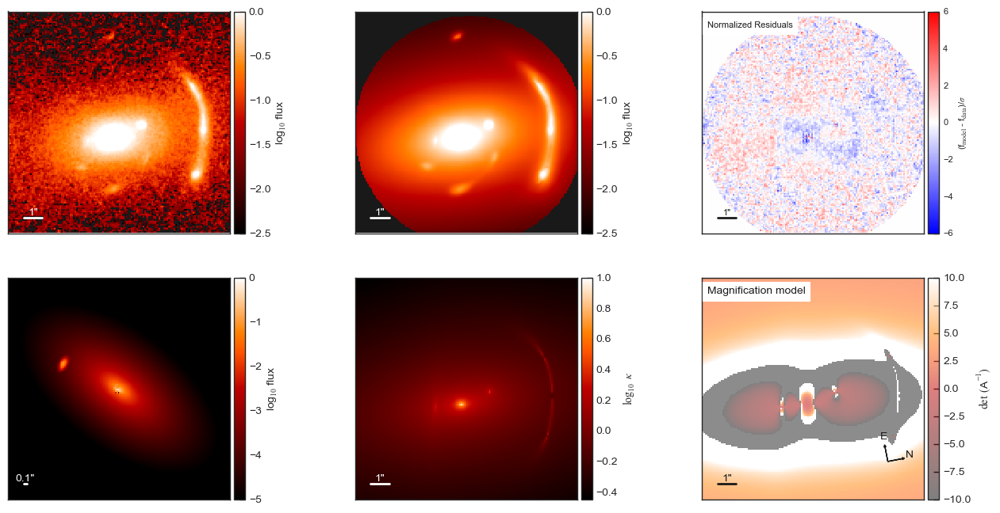

{'kwargs_lens': [{'Rs': 31.073442025905603, 'alpha_Rs': 7.159864948579336, 'e1': -0.36196849751814303, 'e2': -0.048046488223091176, 'center_x': -0.7993550899221548, 'center_y': -0.4809548516745945}, {'gamma_ext': 0.10474938926998188, 'psi_ext': 1.48318453661593, 'ra_0': 0, 'dec_0': 0}, {'theta_E': 0.11001314713225713, 'center_x': -0.41190306164198515, 'center_y': 1.1449900656274565}, {'theta_E': 0.060739494088229685, 'gamma': 2, 'e1': 0.04064538825330239, 'e2': -0.31742713881974927, 'center_x': -1.0765643884686877, 'center_y': 1.0442300306150405}, {'alpha_1': 0.4184151771538207, 'ratio': 0.9898756545476914, 'w_c1': 0.07606501251917679, 'w_t1': 0.3503546630055888, 'e11': -0.03828606850996896, 'e21': -0.016414123702239398, 'w_c2': 0.3444015424969858, 'w_t2': 2.963442854859148, 'e12': -0.3616256326985836, 'e22': -0.01718547191000611, 'center_x': -0.7993550899221548, 'center_y': -0.4809548516745945}, {'theta_E': 0.0895784662481437, 'e1': 0.49417143011170006, 'e2': 0.29529795622917443, 'cen

In [223]:
from lenstronomy.Plots.model_plot import ModelPlot
from lenstronomy.Plots import chain_plot


modelPlot = ModelPlot(multi_band_list_out, kwargs_model, kwargs_result, 
                      arrow_size=0.01, cmap_string="gist_heat", #magma inferno gist_heat
                      image_likelihood_mask_list=kwargs_likelihood['image_likelihood_mask_list']
                      )
#image_likelihood_mask_list=kwargs_likelihood['image_likelihood_mask_list'],
#multi_band_type='multi-linear',linear_solver = True

#param_class = fitting_seq.param_class
#print(param_class.num_param())
#print(chain_list)

#for i in range(len(chain_list)):
#    chain_plot.plot_chain_list(chain_list, i)

f, axes = plt.subplots(2, 3, figsize=(16, 8), sharex=False, sharey=False)

modelPlot.data_plot(ax=axes[0,0],font_size=10,v_min=-2.5,v_max= 0,text=None,no_arrow=True)#v_max= 2, v_min=-8 # text='Observed'default, text=None,no_arrow=True
modelPlot.model_plot(ax=axes[0,1],font_size=10, v_min=-2.5,v_max= 0,text=None,no_arrow=True )#v_max= 2, v_min=-8
modelPlot.normalized_residual_plot(ax=axes[0,2],font_size=8, v_min=-6, v_max=6)
#modelPlot.absolute_residual_plot(ax=axes[0,2],font_size=8, v_min=-0.3, v_max=0.3)
modelPlot.source_plot(ax=axes[1, 0],font_size=10, deltaPix_source=0.04, numPix=150, with_caustics=False,v_max= 0, v_min=-5,text=None,no_arrow=True) #fast_caustic=True,
modelPlot.convergence_plot(ax=axes[1, 1],font_size=10,  v_max=1,text=None,no_arrow=True)
modelPlot.magnification_plot(ax=axes[1, 2],font_size=10)
#f.tight_layout()
#f.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0., hspace=0.05)
#plt.show()

plt.savefig(fname=job_name_out+'wo_caustic4.pdf')
plt.show()
print(kwargs_result)

-0.7868293721264027 reduced X^2 of all evaluated imaging data combined (without degrees of freedom subtracted).
reduced chi^2 of data  0 =  0.7868293721264019


/Users/nandinisahu/git_src/lenstronomy/lenstronomy/Plots/model_band_plot.py:67: RuntimeWarning: divide by zero encountered in log10
  log_model = np.log10(model)


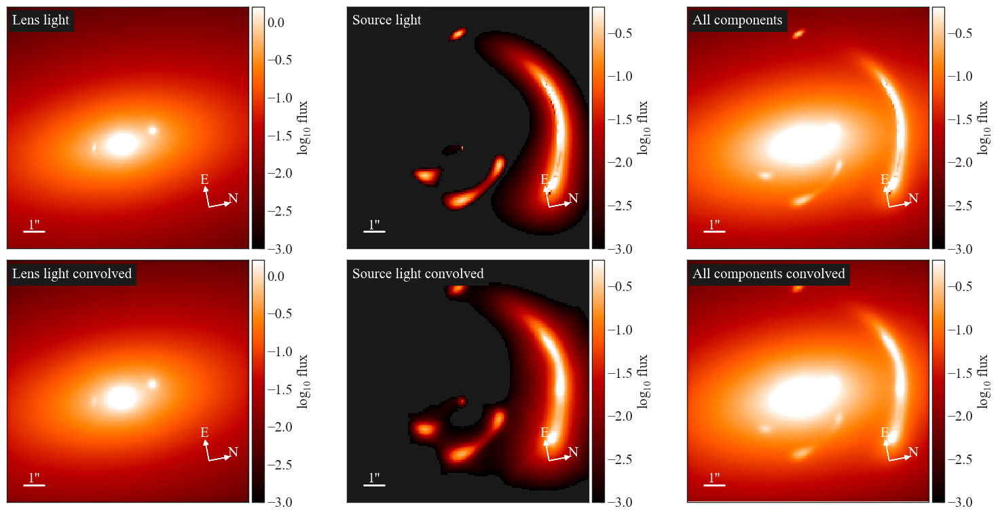

lens [{'Rs': 31.073442025905603, 'alpha_Rs': 7.159864948579336, 'e1': -0.36196849751814303, 'e2': -0.048046488223091176, 'center_x': -0.7993550899221548, 'center_y': -0.4809548516745945}, {'gamma_ext': 0.10474938926998188, 'psi_ext': 1.48318453661593, 'ra_0': 0, 'dec_0': 0}, {'theta_E': 0.11001314713225713, 'center_x': -0.41190306164198515, 'center_y': 1.1449900656274565}, {'theta_E': 0.060739494088229685, 'gamma': 2, 'e1': 0.04064538825330239, 'e2': -0.31742713881974927, 'center_x': -1.0765643884686877, 'center_y': 1.0442300306150405}, {'alpha_1': 0.4184151771538207, 'ratio': 0.9898756545476914, 'w_c1': 0.07606501251917679, 'w_t1': 0.3503546630055888, 'e11': -0.03828606850996896, 'e21': -0.016414123702239398, 'w_c2': 0.3444015424969858, 'w_t2': 2.963442854859148, 'e12': -0.3616256326985836, 'e22': -0.01718547191000611, 'center_x': -0.7993550899221548, 'center_y': -0.4809548516745945}, {'theta_E': 0.0895784662481437, 'e1': 0.49417143011170006, 'e2': 0.29529795622917443, 'center_x': -0.

In [40]:
# band index to plot the model breakdown, 0: F140W, 1: F200LP
band_i = 0

lensPlot = ModelPlot(multi_band_list_out, kwargs_model, kwargs_result, 
                     arrow_size=0.02, cmap_string="gist_heat",
                    image_likelihood_mask_list=kwargs_likelihood['image_likelihood_mask_list'], #kwargs_likelihood['image_likelihood_mask_list'],
                    multi_band_type='multi-linear', linear_solver = True
                    )
#if band_i == 0:
#    i = 'Observed: F140W'
#elif band_i ==1:
#    i = 'Observed: F200LP'

#i = 'Observed: F140W'

f, axes = plt.subplots(2, 3, figsize=(16, 8), sharex=False, sharey=False)

lensPlot.decomposition_plot(ax=axes[0,0], text='Lens light', lens_light_add=True, unconvolved=True, band_index=band_i, v_min=-3,v_max= 0.2) 
lensPlot.decomposition_plot(ax=axes[1,0], text='Lens light convolved', lens_light_add=True, band_index=band_i, v_min=-3,v_max= 0.2) 

lensPlot.decomposition_plot(ax=axes[0,1], text='Source light', source_add=True, unconvolved=True, band_index=band_i, v_min=-3,v_max= -0.2) 
lensPlot.decomposition_plot(ax=axes[1,1], text='Source light convolved', source_add=True, band_index=band_i, v_min=-3,v_max= -0.2) 

lensPlot.decomposition_plot(ax=axes[0,2], text='All components', source_add=True, lens_light_add=True, unconvolved=True, band_index=band_i, v_min=-3,v_max= -0.2) 
lensPlot.decomposition_plot(ax=axes[1,2], text='All components convolved', source_add=True, lens_light_add=True, point_source_add=True, band_index=band_i, v_min=-3,v_max= -0.2) 
f.tight_layout()
f.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0., hspace=0.05)
plt.show()

lens_result, source_result, lens_light_result, ps_result = kwargs_result['kwargs_lens'], kwargs_result['kwargs_source'], kwargs_result['kwargs_lens_light'], kwargs_result['kwargs_ps']
print('lens', lens_result, "\n\n source", source_result, '\n\n lens light', lens_light_result, '\n\n ps', ps_result)


In [41]:
from lenstronomy.Analysis.kinematics_api import KinematicsAPI
from astropy.cosmology import FlatLambdaCDM
import lenstronomy.Util.param_util as param_util
import numpy as np

def get_velocity_dispersion_in_slit( kwargs_mass,#theta_e, gamma, e1,e2,
                                    kwargs_light,
                                    z_d=0.594, z_s=2.591,
                                    anisotropy_type='OM',
                                    ani_param=1.0,
                                    take_mge_mass=False
                                    ):
    cosmo = FlatLambdaCDM(H0=70, Om0=0.3)

    D_d = cosmo.angular_diameter_distance(z_d).value
    D_s = cosmo.angular_diameter_distance(z_s).value
    D_ds = cosmo.angular_diameter_distance_z1z2(z_d, z_s).value

    kwargs_cosmo = {'d_d': D_d, 'd_s': D_s, 'd_ds': D_ds}
    #r_out should be the radius of aperture, SDSS-BOSS diameter=2"
    kwargs_aperture_shell = {'aperture_type': 'shell', 'r_in': 0, 'r_out': 1.0, 'center_ra': -0.80, 'center_dec': -0.48} 
    
    kwargs_seeing = {'psf_type': 'GAUSSIAN', 'fwhm': 1.4}

    kwargs_galkin_numerics = {#'sampling_number': 1000,
                              'interpol_grid_num': 1000,
                              'log_integration': True,
                              'max_integrate': 100,
                              'min_integrate': 0.001}

    kwargs_model = {
            'lens_model_list': ['NFW_ELLIPSE_CSE','DOUBLE_CHAMELEON'], #'CHAMELEON' 'DOUBLE_CHAMELEON'
            'lens_light_model_list': ['DOUBLE_CHAMELEON'], #, 'SERSIC' 'CHAMELEON'
    }


    kinematics_api = KinematicsAPI(z_lens=z_d, z_source=z_s,
                                   kwargs_model=kwargs_model,
                                   kwargs_aperture=kwargs_aperture_shell,
                                   kwargs_seeing=kwargs_seeing,
                                   anisotropy_model=anisotropy_type,
                                   cosmo=cosmo,
                                   multi_observations=False,
                                   kwargs_numerics_galkin=kwargs_galkin_numerics,
                                   analytic_kinematics=False,
                                   Hernquist_approx=False,
                                   MGE_light=True,
                                   MGE_mass=take_mge_mass,
                                   kwargs_mge_light=None,
                                   kwargs_mge_mass=None,
                                   sampling_number=1000,
                                   num_kin_sampling=2000,
                                   num_psf_sampling=500,
                                   )
       

    if anisotropy_type == 'OM':
        kwargs_anisotropy = {
            'r_ani': ani_param
        }
    elif anisotropy_type == 'const':
        kwargs_anisotropy = {
            'beta': ani_param
        }

    vel_dis = kinematics_api.velocity_dispersion(
                    kwargs_mass,
                    kwargs_light,
                    kwargs_anisotropy,
                    kappa_ext=0,
                )

    return vel_dis


kwargs_mass = [kwargs_result['kwargs_lens'][0],kwargs_result['kwargs_lens'][4]]
# 'R_sersic' needs to defined along the intermediate axis
kwargs_light = [kwargs_result['kwargs_lens_light'][0]]

vel_disp_results = []
# Iterate over ani_param values
for ani_param in np.linspace(-0.31, 0.38, num=2):  # 13 steps from -0.3 to 0.3
    x = get_velocity_dispersion_in_slit(kwargs_mass, kwargs_light, ani_param=ani_param,
                                         take_mge_mass=True, anisotropy_type='const')
    vel_disp_results.append(x)
    #print(f'velocity_dispersion for ani_param={ani_param:.2f}: {x}')
    
mean_x = np.mean(vel_disp_results)
err_x=np.std(vel_disp_results)
print(f'Mean velocity_dispersion: {mean_x}')
print(f'Std Deviation velocity_dispersion: {err_x}')


 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.

 NNLS quitting on iteration count.
Mean velocity_dispersion: 243.11558678189033
Std Deviation velocity_dispersion: 17.51298754256436


In [42]:
from lenstronomy.Cosmo.lens_cosmo import LensCosmo
from astropy.cosmology import FlatLambdaCDM
lens_cosmo = LensCosmo(z_lens=0.594, z_source=2.591, cosmo=cosmo)
#units: rho0 [Msun/Mpc^3], Rs [Mpc], c, r200 [Mpc], M200 [Msun]
#c = r200/r
rho0, Rs, c, r200, M200 = lens_cosmo.nfw_angle2physical(Rs_angle=kwargs_result['kwargs_lens'][0]['Rs'], alpha_Rs=kwargs_result['kwargs_lens'][0]['alpha_Rs'])

In [43]:
print('Rs:', Rs*1000,'kpc')
print('r200:',r200*1000,'kpc')
print('Log M200:', np.log10(M200),'dex')
print('c200:',c)

Rs: 206.77139403359772 kpc
r200: 920.5943815232139 kpc
Log M200: 14.23101502819685 dex
c200: 4.452232794704809


In [44]:
6.654*0.13

0.86502

In [45]:
from colossus.halo import concentration
from colossus.cosmology import cosmology

my_cosmo = {
        "flat": True,
        "H0": 70.0,
        "Om0": 0.3,
        "Ob0": 0.05,
        "sigma8": 0.823, #represents the root-mean-square fluctuation of matter density at a scale of 8/h Mpc in the universe today h=H0/100
        "ns": 0.96, #slope of the power spectrum of primordial density fluctuations
    }  # fiducial cosmo

cosmo1 = cosmology.setCosmology("my_cosmo", my_cosmo)

c200_rln = concentration.concentration(
        M200 * cosmo1.h,  #  input halo mass needs to be in M_sun/h unit
        "200c",
        0.594,
        model="diemer19"
    )
print(c200_rln)

3.7960291498764813


In [46]:
#gavazzi et al. 2007 equation 13
c_gavazii=(9/(1+0.594))*((M200*cosmo1.h/(8.12e12))**(-0.14))
print(c_gavazii)

3.8764680328187695


In [47]:
Mvir_gavazzi=246*((10**10.7357)*cosmo1.h) #in Msolar
print(np.log10(Mvir_gavazzi))
c_gavazii07=(9/(1+0.594))*((Mvir_gavazzi*cosmo1.h/(8.12e12))**(-0.14))
print(c_gavazii07)

12.971733147117636
5.817490332839276


In [48]:
#stellar mass calculation
from lenstronomy.Analysis.lens_profile import LensProfileAnalysis
from lenstronomy.Cosmo.lens_cosmo import LensCosmo

lens_model_list1 = lens_model_list #['NFW_ELLIPSE_CSE', 'DOUBLE_CHAMELEON']
lens_redshift_list1= lens_redshift_list #[0.594, 0.594]

lens_analysis_main_lens = LensProfileAnalysis(
        LensModel(
            lens_model_list=[lens_model_list1[0],lens_model_list1[4]], #lens_model_list1,
            #z_lens=z_lens,
            lens_redshift_list=[lens_redshift_list1[0],lens_redshift_list1[4]],
            z_source=2.591, #z_source,
            multi_plane=False,  #  multi_plane=True does not work here
        )
    )
num_pix = 400
aperture_size = 3*3 #10 #in arcsec how to decide 3*Reff ?? use large enough value
mean_convergence_main_lens = lens_analysis_main_lens.mass_fraction_within_radius(
        [kwargs_result['kwargs_lens'][0],kwargs_result['kwargs_lens'][4]],
      kwargs_result['kwargs_lens'][4]["center_x"],
      kwargs_result['kwargs_lens'][4]["center_y"],
        aperture_size,
        numPix=num_pix,
    )
print("mean convergence for main lens:", mean_convergence_main_lens) #list of average convergences for all the model components

REins_grid_main_lens=lens_analysis_main_lens.effective_einstein_radius_grid([kwargs_result['kwargs_lens'][0],
                                                                   kwargs_result['kwargs_lens'][4]], 
                                                                  center_x=kwargs_result['kwargs_lens'][4]["center_x"],
                                                                  center_y=kwargs_result['kwargs_lens'][4]["center_y"])
print("effective Einestein radius of main lens (radius with mean kappa=1):", REins_grid_main_lens)

REins_main_lens=lens_analysis_main_lens.effective_einstein_radius([kwargs_result['kwargs_lens'][0],kwargs_result['kwargs_lens'][4]])
print("effective Einestein radius of main lens (numerical estimate):",REins_main_lens)


lens_cosmo = LensCosmo(z_lens=0.594, z_source=2.591)
surface_density_main_lens_cmpt2 = lens_cosmo.kappa2proj_mass(mean_convergence_main_lens[1])
#print(surface_density_main_lens_cmpt2)
delta_pixel = 2.0 * aperture_size / num_pix
stellar_mass = (
        surface_density_main_lens_cmpt2 * lens_cosmo.dd**2 * np.pi * (aperture_size / 206265) ** 2
    )
print("stellar mass component of main lens (in log):",np.log10(stellar_mass))

surface_density_main_lens_all_cmpt = lens_cosmo.kappa2proj_mass(mean_convergence_main_lens[0]+mean_convergence_main_lens[1])
#print(surface_density_main_lens_cmpt2)
delta_pixel = 2.0 * aperture_size / num_pix
total_mass = (
        surface_density_main_lens_all_cmpt * lens_cosmo.dd**2 * np.pi * (aperture_size / 206265) ** 2
    )
print("Total mass of the main lens (in log):",np.log10(total_mass))


mean convergence for main lens: [0.5508058294249772, 0.01577419493405591]
effective Einestein radius of main lens (radius with mean kappa=1): 3.145363408521303
effective Einestein radius of main lens (numerical estimate): 2.8740406740727265
stellar mass component of main lens (in log): 11.547233571606306
Total mass of the main lens (in log): 13.102547626908253


In [49]:
kwargs_result['kwargs_lens'][1]

{'gamma_ext': 0.10474938926998188,
 'psi_ext': 1.48318453661593,
 'ra_0': 0,
 'dec_0': 0}

In [50]:
lens_analysis_gal1 = LensProfileAnalysis(
        LensModel(
            lens_model_list=[lens_model_list1[2]], #lens_model_list1,
            #z_lens=0.594,
            lens_redshift_list=[lens_redshift_list1[2]],
            z_source=2.591, #z_source,
            multi_plane=False,  #  multi_plane=True does not work here
        )
    )

num_pix = 100
aperture_size = 3*0.32 #2.5 #in arcsec how to decide 3*Reff ?? use large enough value

mean_convergence_gal1 = lens_analysis_gal1.mass_fraction_within_radius(
        [kwargs_result['kwargs_lens'][2]],
      kwargs_result['kwargs_lens'][2]["center_x"],
      kwargs_result['kwargs_lens'][2]["center_y"],
        aperture_size,
        numPix=num_pix,
    )

#note mean convergence value will change depending on num_pix and aperture_size, so does total mass, but does not affect REins 
print("mean convergence for gal1:", mean_convergence_gal1) #list of average convergences for all the model components


REins_grid_gal1=lens_analysis_gal1.effective_einstein_radius_grid([kwargs_result['kwargs_lens'][2]], 
                                                                  center_x=kwargs_result['kwargs_lens'][2]["center_x"],
                                                                  center_y=kwargs_result['kwargs_lens'][2]["center_y"])
print("effective Einestein radius of gal1 (radius with mean kappa=1):", REins_grid_gal1)

REins_gal1=lens_analysis_gal1.effective_einstein_radius([kwargs_result['kwargs_lens'][2]])
print("effective Einestein radius of gal1 (numerical estimate):",REins_gal1)


lens_cosmo = LensCosmo(z_lens=0.594, z_source=2.591)
surface_density_gal1= lens_cosmo.kappa2proj_mass(mean_convergence_gal1[0])
#print(surface_density_main_lens_cmpt2)
delta_pixel = 2.0 * aperture_size / num_pix
Total_mass_gal1 = (
        surface_density_gal1 * lens_cosmo.dd**2 * np.pi * (aperture_size / 206265) ** 2
    )
print("Total mass of gal1 (in log):",np.log10(Total_mass_gal1))

mean convergence for gal1: [0.11396450899231807]
effective Einestein radius of gal1 (radius with mean kappa=1): 0.08771929824561403
effective Einestein radius of gal1 (numerical estimate): nan
Total mass of gal1 (in log): 10.46211343908444


In [51]:
lens_analysis_gal2 = LensProfileAnalysis(
        LensModel(
            lens_model_list=[lens_model_list1[5]], #lens_model_list1,
            #z_lens=z_lens,
            lens_redshift_list=[lens_redshift_list1[5]],
            z_source=2.591, #z_source,
            multi_plane=False,  #  multi_plane=True does not work here
        )
    )

num_pix = 50
aperture_size = 3*0.14 #2.5 #in arcsec how to decide 3*Reff ?? use large enough value

mean_convergence_gal2 = lens_analysis_gal2.mass_fraction_within_radius(
        [kwargs_result['kwargs_lens'][5]],
      kwargs_result['kwargs_lens'][5]["center_x"],
      kwargs_result['kwargs_lens'][5]["center_y"],
        aperture_size,
        numPix=num_pix,
    )

#note mean convergence value will change depending on num_pix and aperture_size but does not affect total mass, REins etc.
print("mean convergence for  gal2 :", mean_convergence_gal2) #list of average convergences for all the model components


REins_grid_gal2=lens_analysis_gal2.effective_einstein_radius_grid([kwargs_result['kwargs_lens'][5]], 
                                                                  center_x=kwargs_result['kwargs_lens'][5]["center_x"],
                                                                  center_y=kwargs_result['kwargs_lens'][5]["center_y"])
print("effective Einestein radius of  gal2  (radius with mean kappa=1):", REins_grid_gal2)

REins_gal2=lens_analysis_gal2.effective_einstein_radius([kwargs_result['kwargs_lens'][5]])
print("effective Einestein radius of  gal2  (numerical estimate):",REins_gal2)


lens_cosmo = LensCosmo(z_lens=0.594, z_source=2.591)
surface_density_gal2= lens_cosmo.kappa2proj_mass(mean_convergence_gal2[0])
#print(surface_density_main_lens_cmpt2)
delta_pixel = 2.0 * aperture_size / num_pix
Total_mass_gal2 = (
        surface_density_gal2 * lens_cosmo.dd**2 * np.pi * (aperture_size / 206265) ** 2
    )
print("Total mass of gal2 (in log):",np.log10(Total_mass_gal2))

mean convergence for  gal2 : [0.1891453907347317]
effective Einestein radius of  gal2  (radius with mean kappa=1): nan
effective Einestein radius of  gal2  (numerical estimate): nan
Total mass of gal2 (in log): 9.964095692562486


In [52]:
kwargs_result['kwargs_lens'][3]

{'theta_E': 0.060739494088229685,
 'gamma': 2,
 'e1': 0.04064538825330239,
 'e2': -0.31742713881974927,
 'center_x': -1.0765643884686877,
 'center_y': 1.0442300306150405}

In [53]:
0.15486475107519587*148.19/1017.76

0.02254893831731771

In [54]:
lens_analysis_src1 = LensProfileAnalysis(
        LensModel(
            lens_model_list=[lens_model_list1[3]], #lens_model_list1,
            #z_lens=0.594, #z_lens,
            lens_redshift_list=[lens_redshift_list1[3]],
            z_source=2.591, #z_source,
            multi_plane=False,  #  multi_plane=True does not work here
        )
    )

num_pix = 50
aperture_size = 3*0.19 #2.5 #in arcsec how to decide 3*Reff ?? use large enough value

#kwargs_src1=kwargs_result['kwargs_lens'][3]
#kwargs_src1['theta_E']=0.0225
# Doing this because there is some problen with updating dictionary
#kwargs_result['kwargs_lens'][3]= {'theta_E': 0.15486475107519587,'gamma': 2, 'e1': 0.010758971775141735, #0.15486475107519587
#                            'e2': -0.2938465336994596, 'center_x': -1.0834184256993902, 'center_y': 1.248792625477853}

print(kwargs_result['kwargs_lens'][3])
mean_convergence_src1 = lens_analysis_src1.mass_fraction_within_radius(
        [kwargs_result['kwargs_lens'][3]],
       #[kwargs_src1],
      kwargs_result['kwargs_lens'][3]["center_x"],
      kwargs_result['kwargs_lens'][3]["center_y"],
        aperture_size,
        numPix=num_pix,
    )

#note mean convergence value will change depending on num_pix and aperture_size but does not affect total mass, REins etc.
print("mean convergence for src1:", mean_convergence_src1) #list of average convergences for all the model components


REins_grid_src1=lens_analysis_src1.effective_einstein_radius_grid([kwargs_result['kwargs_lens'][3]], 
                                                                  center_x=kwargs_result['kwargs_lens'][3]["center_x"],
                                                                  center_y=kwargs_result['kwargs_lens'][3]["center_y"])
print("effective Einestein radius of src1(radius with mean kappa=1):", REins_grid_src1)

REins_src1=lens_analysis_src1.effective_einstein_radius([kwargs_result['kwargs_lens'][3]])
print("effective Einestein radius of src1 (numerical estimate):",REins_src1)


lens_cosmo = LensCosmo(z_lens=2.163 , z_source=2.591) #   0.594 , 2.163
surface_density_src1= lens_cosmo.kappa2proj_mass(mean_convergence_src1[0])
#print(surface_density_main_lens_cmpt2)
delta_pixel = 2.0 * aperture_size / num_pix
Total_mass_src1 = (
        surface_density_src1 * lens_cosmo.dd**2 * np.pi * (aperture_size / 206265) ** 2
    )
print("Total mass of src1 (in log):",np.log10(Total_mass_src1))

{'theta_E': 0.060739494088229685, 'gamma': 2, 'e1': 0.04064538825330239, 'e2': -0.31742713881974927, 'center_x': -1.0765643884686877, 'center_y': 1.0442300306150405}
mean convergence for src1: [0.10257591191814755]
effective Einestein radius of src1(radius with mean kappa=1): nan
effective Einestein radius of src1 (numerical estimate): nan
Total mass of src1 (in log): 10.911241330347705


In [55]:
from lenstronomy.Analysis.light_profile import LightProfileAnalysis
#light_analysis=LightProfileAnalysis(LightModel([lens_light_model_list[1]] )) # for single component
#component_flux=light_analysis.flux_components([kwargs_result['kwargs_lens_light'][1]]) # for single component
lens_light_analysis=LightProfileAnalysis(LightModel(lens_light_model_list))

component_flux=lens_light_analysis.flux_components(kwargs_result['kwargs_lens_light'])
#Computes the total flux in each component of the model.
print("flux and half-light radius",component_flux)

flux and half-light radius ([1649.4023915389691, 75.762142620702, 9.003403487454735], [0.8181932565109541, 0.2539220451240892, 0.10721153016350433])


In [56]:
source_light_analysis=LightProfileAnalysis(LightModel(source_model_list))
source_flux=source_light_analysis.flux_components(kwargs_result['kwargs_source'])
print("flux and half-light radius",source_flux)

flux and half-light radius ([10.542357643494272, 0.38219264224686617, 0.7778081307240415], [0.1918522118715341, 0.03949898479708054, 0.062069833252555134])


### sourc1 luminosity and predicted velocity dispersion (via z~0 M--sigma relation)

In [57]:
#reference for high redshift galaxies https://arxiv.org/pdf/2003.01725

D_ang_dia= D_s1 #D_l  D_s1
vel_disp_model=45 #180, 245, 303 115
vel_disp_obs=68
count=10.427120342424857+ 0.6049167239414845 #1646.684542265908, 13.5975

gal_tot_flux=count #np.mean(count)
err_gal_tot_flux=1 #np.std(count)
print('total flux (e-/s):', gal_tot_flux)
print('uncertainty in total flux:',25)

PHOTFLAM= 1.4759001E-20 #Inverse sensitivity, ergs/cm2/A/e- 
STmag_ZP=-21.10  
PHOTPLAM=1.3922907E+04  #pivot wavelength (Angstroms)    

Lens_mag_STmag=-2.5*np.log10(gal_tot_flux*PHOTFLAM)+STmag_ZP  #flux units e-/s        

Lens_mag=Lens_mag_STmag -5*np.log10(PHOTPLAM)+18.692 #AB mag

Lens_mag_plus=-2.5*np.log10((gal_tot_flux+err_gal_tot_flux)*PHOTFLAM)-STmag_ZP -5*np.log10(PHOTPLAM)+18.692
Lens_mag_minus=-2.5*np.log10((gal_tot_flux-err_gal_tot_flux)*PHOTFLAM)-STmag_ZP -5*np.log10(PHOTPLAM)+18.692
e_Lens_mag=(Lens_mag_minus-Lens_mag_plus)/2
print('Mag_gal_AB:',Lens_mag)
print('err_Mag_gal_AB:', e_Lens_mag)

Mag_abs=Lens_mag-5*np.log10(D_ang_dia)-25 
print('Absolute mag', Mag_abs)
Mag_sun=4.56 # https://iopscience.iop.org/article/10.3847/1538-4365/aabfdf/pdf
luminosity=10**(-Mag_abs/2.5)/10**(-Mag_sun/2.5)
print("luminosity in terms of L_solar in log:", np.log10(luminosity))

vel=(luminosity)**(1/4)
print(vel)
lum=vel_disp_obs**4
print(np.log10(lum))
#doing following predictions is wrong,because the luminosity band is different
#vel_disp_pred= (10**((np.log10(luminosity) -8.41)/2.44))*200 #from Sahu et al. 2019b, sersic, v-band z~0 relation 
#print("predicted velocity dispersion in km/s:", vel_disp_pred)
#log_lum_pred= 2.44*np.log10(vel_disp_model/200) + 8.41 #from Sahu et al. 2019b, sersic, z~0 relation 
#print("predicted luminosity from model predicted vel disp ", log_lum_pred)

total flux (e-/s): 11.03203706636634
uncertainty in total flux: 25
Mag_gal_AB: 23.844068702611107
err_Mag_gal_AB: 0.09868754129200852
Absolute mag -17.320093153527058
luminosity in terms of L_solar in log: 8.752037261410823
154.17335218419998
7.330035650824946


In [58]:
np.log10(68)

1.8325089127062364

### main lens magnitude

In [59]:
D_ang_dia= D_l #D_l  D_s1
vel_disp_model=260 #180, 245, 303 115
vel_disp_obs=303
count=1648.073381867503 #1646.684542265908, 13.5975

gal_tot_flux=count #np.mean(count)
err_gal_tot_flux=10 #np.std(count)
print('total flux (e-/s):', gal_tot_flux)
print('uncertainty in total flux:',err_gal_tot_flux)

PHOTFLAM= 1.4759001E-20 #Inverse sensitivity, ergs/cm2/A/e- 
STmag_ZP=-21.10  
PHOTPLAM=1.3922907E+04  #pivot wavelength (Angstroms)    

Lens_mag_STmag=-2.5*np.log10(gal_tot_flux*PHOTFLAM)+STmag_ZP  #flux units e-/s        

Lens_mag=Lens_mag_STmag -5*np.log10(PHOTPLAM)+18.692 #AB mag

Lens_mag_plus=-2.5*np.log10((gal_tot_flux+err_gal_tot_flux)*PHOTFLAM)-STmag_ZP -5*np.log10(PHOTPLAM)+18.692
Lens_mag_minus=-2.5*np.log10((gal_tot_flux-err_gal_tot_flux)*PHOTFLAM)-STmag_ZP -5*np.log10(PHOTPLAM)+18.692
e_Lens_mag=(Lens_mag_minus-Lens_mag_plus)/2
print('Mag_gal_AB:',Lens_mag)
print('err_Mag_gal_AB:', e_Lens_mag)

Mag_abs=Lens_mag-5*np.log10(D_ang_dia)-25 
print('Absolute mag', Mag_abs)
Mag_sun=4.56 # https://iopscience.iop.org/article/10.3847/1538-4365/aabfdf/pdf
luminosity=10**(-Mag_abs/2.5)/10**(-Mag_sun/2.5)
print("luminosity in terms of L_solar in log:", np.log10(luminosity))

vel=(luminosity)**(1/4)
print(vel)
lum=vel_disp_obs**4
print(np.log10(lum))
#doing following predictions is wrong,because the luminosity band is different
#vel_disp_pred= (10**((np.log10(luminosity) -8.41)/2.44))*200 #from Sahu et al. 2019b, sersic, v-band z~0 relation 
#print("predicted velocity dispersion in km/s:", vel_disp_pred)
#log_lum_pred= 2.44*np.log10(vel_disp_model/200) + 8.41 #from Sahu et al. 2019b, sersic, z~0 relation 
#print("predicted luminosity from model predicted vel disp ", log_lum_pred)

total flux (e-/s): 1648.073381867503
uncertainty in total flux: 10
Mag_gal_AB: 18.408266620678592
err_Mag_gal_AB: 0.0065879926310898895
Absolute mag -22.27936450882752
luminosity in terms of L_solar in log: 10.735745803531008
482.98812254495294
9.92577051400922


### Plot result model centres

/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/1439745705.py:3: RuntimeWarning: invalid value encountered in log10
  ax.matshow(np.log10(data_cutout), origin='lower', cmap=cmap, vmin=-3, vmax=1.)


90.38161177893683 64.281123076333


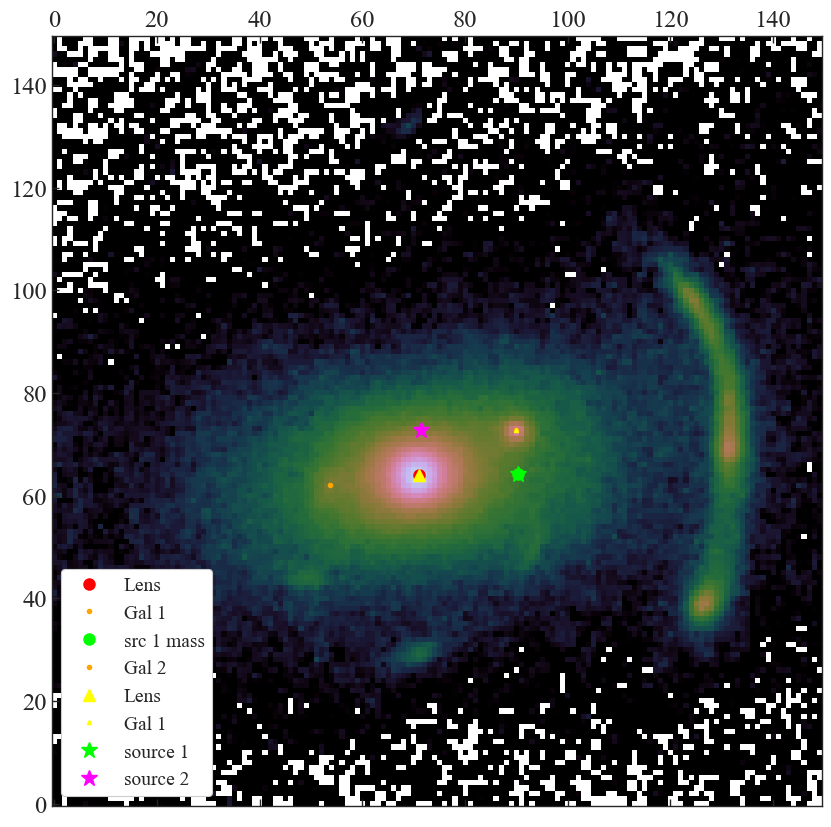

In [60]:

data_cutout = kwargs_data_F140W['image_data']
ax = plt.figure(figsize=(10, 10)).add_subplot(111)
ax.matshow(np.log10(data_cutout), origin='lower', cmap=cmap, vmin=-3, vmax=1.)
ax.autoscale(False)

#mass
lens_mass_x, lens_mass_y=coords.map_coord2pix(kwargs_result['kwargs_lens'][0]['center_x'],kwargs_result['kwargs_lens'][0]['center_y'] )
ax.plot(lens_mass_x, lens_mass_y, 'o', color='red',markersize=8, label='Lens') 
gal1_mass_x, gal1_mass_y=coords.map_coord2pix(kwargs_result['kwargs_lens'][2]['center_x'],kwargs_result['kwargs_lens'][2]['center_y'])
ax.plot(gal1_mass_x, gal1_mass_y, 'o', color='orange',markersize=3, label='Gal 1') 
src1_mass_x, src1_mass_y=coords.map_coord2pix(kwargs_result['kwargs_lens'][3]['center_x'],kwargs_result['kwargs_lens'][3]['center_y'] )
ax.plot(src1_mass_x, src1_mass_y, 'o', color='lime',markersize=8, label='src 1 mass') 
gal2_mass_x, gal2_mass_y=coords.map_coord2pix(kwargs_result['kwargs_lens'][5]['center_x'],kwargs_result['kwargs_lens'][5]['center_y'])
ax.plot(gal2_mass_x, gal2_mass_y, 'o', color='orange',markersize=3, label='Gal 2') 


#light
lens_light_x,lens_light_y=coords.map_coord2pix(kwargs_result['kwargs_lens_light'][0]['center_x'],kwargs_result['kwargs_lens_light'][0]['center_y'])
gal1_light_x,gal1_light_y=coords.map_coord2pix(kwargs_result['kwargs_lens_light'][1]['center_x'],kwargs_result['kwargs_lens_light'][1]['center_y'])
ax.plot(lens_light_x,lens_light_y, '^', color='yellow',markersize=8, label='Lens') 
ax.plot(gal1_light_x,gal1_light_y, '^', color='yellow',markersize=3, label='Gal 1')

#source
src1_x,src1_y=coords.map_coord2pix(kwargs_result['kwargs_source'][0]['center_x'],kwargs_result['kwargs_source'][0]['center_y'])
src2_x,src2_y=coords.map_coord2pix(kwargs_result['kwargs_source'][2]['center_x'],kwargs_result['kwargs_source'][2]['center_y'])

ax.plot(src1_x,src1_y, '*', color='lime', markersize=12, label='source 1')
ax.plot(src2_x,src2_y, '*', color='magenta',markersize=12,label='source 2')
print(src1_x,src1_y)

plt.legend(loc=3,fontsize=14, framealpha=1)
plt.show()

In [61]:
fit_output[0][1][1][-1]

1.0207449306069314

In [62]:
'''
parameter_names=fit_output[0][2]
likelihood_list=fit_output[0][1][0]
parameter_value_list=fit_output[2][1][1]
parameter_uncer_list=fit_output[2][1][2]
final_para={}
for i in range(len(parameter_names)):
    final_para['%s'%parameter_names[i]]=(parameter_value_list[-1][i], parameter_uncer_list[-1][i])
    
final_para
'''

"\nparameter_names=fit_output[0][2]\nlikelihood_list=fit_output[0][1][0]\nparameter_value_list=fit_output[2][1][1]\nparameter_uncer_list=fit_output[2][1][2]\nfinal_para={}\nfor i in range(len(parameter_names)):\n    final_para['%s'%parameter_names[i]]=(parameter_value_list[-1][i], parameter_uncer_list[-1][i])\n    \nfinal_para\n"

/var/folders/v5/068qyr6n1v16l5m5qs3sthxm0000gn/T/ipykernel_3675/2445956617.py:15: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if not samples_mcmc == []:


N_step: 2000, N_walkers: 304, N_params: 38
Rs_lens0 29.5774 ± 2.5915
alpha_Rs_lens0 6.9166 ± 0.3591
e1_lens0 -0.3582 ± 0.0065
e2_lens0 -0.0476 ± 0.0026
gamma_ext_lens1 0.0983 ± 0.0077
psi_ext_lens1 1.4724 ± 0.0207
theta_E_lens2 0.1304 ± 0.0190
theta_E_lens3 0.0383 ± 0.0323
alpha_1_lens4 0.3910 ± 0.0471
theta_E_lens5 0.1031 ± 0.0117
R_sersic_source_light0 0.1858 ± 0.0097
n_sersic_source_light0 2.3407 ± 0.2631
e1_source_light0 0.0242 ± 0.0117
e2_source_light0 -0.3173 ± 0.0149
center_x_source_light0 -1.0722 ± 0.0074
center_y_source_light0 1.0544 ± 0.0343
beta_source_light1 0.0258 ± 0.0010
center_x_source_light1 -1.0837 ± 0.0070
center_y_source_light1 1.0071 ± 0.0335
R_sersic_source_light2 0.0568 ± 0.0023
n_sersic_source_light2 0.5496 ± 0.0898
e1_source_light2 0.0479 ± 0.0277
e2_source_light2 0.3152 ± 0.0291
center_x_source_light2 -0.1105 ± 0.0242
center_y_source_light2 -0.3221 ± 0.0270
center_x_lens_light0 -0.8000 ± 0.0008
center_y_lens_light0 -0.4814 ± 0.0010
R_sersic_lens_light1 0.3230 

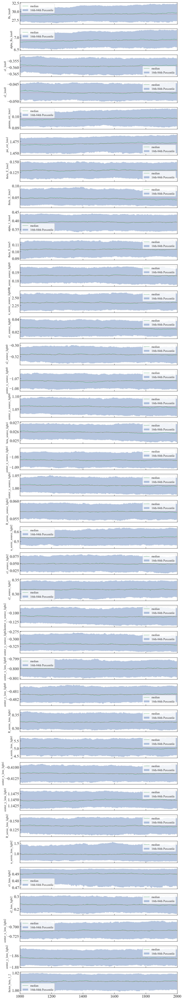

In [63]:
samples_mcmc = []

if fit_output[-1][0] != 'PSO':
    # if MCMC chain was broken in the chunks, we join the chunks to make the full chain
    mcmc_repeat = 1
      
    for k in range(len(fit_output)-mcmc_repeat, len(fit_output)):
        if samples_mcmc == []:
            samples_mcmc = fit_output[k][1]
        else:
            samples_mcmc = np.vstack((samples_mcmc, fit_output[k][1]))

        param_mcmc = fit_output[k][2]
    
if not samples_mcmc == []:
    n_params = samples_mcmc.shape[1]

    n_walkers = 8 * n_params
    n_step = int(samples_mcmc.shape[0] / n_walkers)

    print('N_step: {}, N_walkers: {}, N_params: {}'.format(n_step, n_walkers, n_params))

    chain = np.empty((n_walkers, n_step, n_params))

    for i in np.arange(n_params):
        samples = samples_mcmc[:, i].T
        chain[:,:,i] = samples.reshape((n_step, n_walkers)).T

    mean_pos = np.zeros((n_params, n_step))
    median_pos = np.zeros((n_params, n_step))
    std_pos = np.zeros((n_params, n_step))
    q16_pos = np.zeros((n_params, n_step))
    q84_pos = np.zeros((n_params, n_step))

    for i in np.arange(n_params):
        for j in np.arange(n_step):
            mean_pos[i][j] = np.mean(chain[:, j, i])
            median_pos[i][j] = np.median(chain[:, j, i])
            std_pos[i][j] = np.std(chain[:, j, i])
            q16_pos[i][j] = np.percentile(chain[:, j, i], 16.)
            q84_pos[i][j] = np.percentile(chain[:, j, i], 84.)

    fig, ax = plt.subplots(n_params, sharex=True, figsize=(8, 6))

    burnin = 1000 #-1
    last = n_step

    medians = []

    param_values = [median_pos[0][last-1], (q84_pos[0][last-1]-q16_pos[0][last-1])/2,
                    median_pos[1][last-1], (q84_pos[1][last-1]-q16_pos[1][last-1])/2]

    for i in range(n_params):
        print(param_mcmc[i], '{:.4f} ± {:.4f}'.format(median_pos[i][last-1], (q84_pos[i][last-1]-q16_pos[i][last-1])/2))

        ax[i].plot(median_pos[i][:last], c='g', label='median',lw=1)
        ax[i].axhline(np.median(median_pos[i][burnin:last]), c='r', lw=0.5)
        ax[i].fill_between(np.arange(last), q84_pos[i][:last], q16_pos[i][:last], alpha=0.4,label='16th-84th Percentile')
        ax[i].set_ylabel(param_mcmc[i], fontsize=12)
        ax[i].set_xlim(1000, last)
        ax[i].legend(fontsize=12)
        
        medians.append(np.median(median_pos[i][burnin:last]))

    if True:
        fig.set_size_inches((12., 2*len(param_mcmc)))
        plt.savefig(f'/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/Paper_DSPL/{job_name_out}_Trace_Plot_last1000.pdf') #, dpi=1200
        plt.show()

### Trace plot about mean

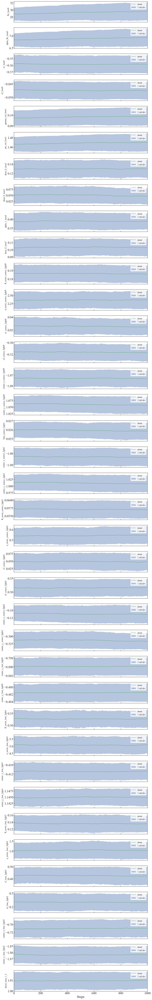

In [64]:
# Extract the MCMC samples and remove the burn-in phase
burn_in_steps = 1000 # Set this if you want to remove some steps as burn-in

#n_step, n_walkers, n_params
mcmc_samples=samples_mcmc[burn_in_steps * n_walkers:]
mcmc_samples_3d = samples_mcmc.reshape((n_step, n_walkers, -1))
#mcmc_samples=samples

# Check if there are any samples
if mcmc_samples.size > 0:
    # Determine the number of parameters and steps
    n_params = mcmc_samples.shape[1]
    chain = mcmc_samples_3d #sampler.get_chain()   ## 3D Shape: (n_steps_mcmc, n_walkers, n_params)
    chain = chain[burn_in_steps:]  # Discard burn-in if any
    n_steps = chain.shape[0]

    # Initialize arrays to store statistics
    mean_pos = np.zeros((n_params, n_steps))
    median_pos = np.zeros((n_params, n_steps))
    std_pos = np.zeros((n_params, n_steps))
    q16_pos = np.zeros((n_params, n_steps))
    q84_pos = np.zeros((n_params, n_steps))

    # Calculate statistics for each parameter at each step
    for i in range(n_params):
        for j in range(n_steps):
            mean_pos[i][j] = np.mean(chain[j, :, i])
            median_pos[i][j] = np.median(chain[j, :, i])
            std_pos[i][j] = np.std(chain[j, :, i])
            q16_pos[i][j] = np.percentile(chain[j, :, i], 16.)
            q84_pos[i][j] = np.percentile(chain[j, :, i], 84.)
            #print( mean_pos[i][j])
            #print(std_pos[i][j] )

    # Plotting the chains with median, and 16th-84th percentiles
    #fig, ax = plt.subplots(n_params, sharex=True, figsize=(16, 8))
    fig, ax = plt.subplots(n_params, sharex=True, figsize=(8, 6))
    param_names = param_mcmc #[r"$w$", r"$\Omega_m$"]  # Adjust this if you have different parameters
    for i in range(n_params):
 #       ax[i].plot(median_pos[i], c='g', label='Median')
 #       ax[i].fill_between(np.arange(n_steps), q16_pos[i], q84_pos[i], alpha=0.4, label='16th-84th Percentile')
        ax[i].plot(mean_pos[i], c='g', label='mean')
        ax[i].fill_between(np.arange(n_steps), mean_pos[i]-std_pos[i], mean_pos[i]+std_pos[i], alpha=0.4, label='1 std dev')
        ax[i].set_ylabel(param_names[i], fontsize=12)
        ax[i].legend(fontsize=12)

    ax[-1].set_xlim(0, n_steps)
    ax[-1].set_xlabel('Steps')
    fig.set_size_inches((12, 2.0 * n_params)) #12., 5 * n_params
    plt.tight_layout()


In [70]:
sampler_type, samples_mcmc, param_mcmc, dist_mcmc  = fit_output[0]
    
print("number of non-linear parameters in the MCMC process: ", len(param_mcmc))
print("parameters in order: ", param_mcmc)
print("number of evaluations in the MCMC process: ", np.shape(samples_mcmc)[0])

import corner
n, num_param = np.shape(samples_mcmc)
#plot = corner.corner(samples_mcmc[:,:8], labels=param_mcmc[:8], show_titles=True)

number of non-linear parameters in the MCMC process:  38
parameters in order:  ['Rs_lens0', 'alpha_Rs_lens0', 'e1_lens0', 'e2_lens0', 'gamma_ext_lens1', 'psi_ext_lens1', 'theta_E_lens2', 'theta_E_lens3', 'alpha_1_lens4', 'theta_E_lens5', 'R_sersic_source_light0', 'n_sersic_source_light0', 'e1_source_light0', 'e2_source_light0', 'center_x_source_light0', 'center_y_source_light0', 'beta_source_light1', 'center_x_source_light1', 'center_y_source_light1', 'R_sersic_source_light2', 'n_sersic_source_light2', 'e1_source_light2', 'e2_source_light2', 'center_x_source_light2', 'center_y_source_light2', 'center_x_lens_light0', 'center_y_lens_light0', 'R_sersic_lens_light1', 'n_sersic_lens_light1', 'center_x_lens_light1', 'center_y_lens_light1', 'R_sersic_lens_light2', 'n_sersic_lens_light2', 'e1_lens_light2', 'e2_lens_light2', 'center_x_lens_light2', 'center_y_lens_light2', 'factor_beta_1_2']
number of evaluations in the MCMC process:  608000


In [89]:
burnin_steps=1000*n_walkers

# Your MCMC sample
sample = samples_mcmc[burnin_steps:, :]  # Last part of the sample, excluding burn-in
col_name = param_mcmc[:]           # Parameter names

# Calculate the median for each parameter
medians = np.median(sample, axis=0)
q16_pos = np.percentile(sample, 16.,axis=0)
q84_pos = np.percentile(sample, 84.,axis=0)

bound68_sym=np.abs((q84_pos-q16_pos)/2)

for i in range(n_params):
    print(param_mcmc[i], '{:.5f} +{:.5f}  -{:.5f}'.format(medians[i], (q84_pos[i]-medians[i]), (medians[i]-q16_pos[i])))

print("\n \n symmetric error")    
for i in range(n_params):
    print(param_mcmc[i], '{:.5f} +/-{:.5f}'.format(medians[i], bound68_sym[i]))

Rs_lens0 29.20878 +2.44419  -2.29338
alpha_Rs_lens0 6.86412 +0.37243  -0.31459
e1_lens0 -0.35885 +0.00636  -0.00663
e2_lens0 -0.04744 +0.00274  -0.00239
gamma_ext_lens1 0.09802 +0.00722  -0.00690
psi_ext_lens1 1.47028 +0.01544  -0.02051
theta_E_lens2 0.12987 +0.01874  -0.01901
theta_E_lens3 0.04426 +0.04245  -0.02921
alpha_1_lens4 0.39164 +0.04511  -0.05322
theta_E_lens5 0.10333 +0.01191  -0.01174
R_sersic_source_light0 0.18633 +0.00964  -0.00956
n_sersic_source_light0 2.34053 +0.29411  -0.24674
e1_source_light0 0.02587 +0.01278  -0.01274
e2_source_light0 -0.31625 +0.01400  -0.01452
center_x_source_light0 -1.07253 +0.00727  -0.00809
center_y_source_light0 1.06003 +0.03384  -0.03311
beta_source_light1 0.02594 +0.00092  -0.00090
center_x_source_light1 -1.08321 +0.00759  -0.00731
center_y_source_light1 1.01129 +0.03279  -0.03285
R_sersic_source_light2 0.05699 +0.00238  -0.00229
n_sersic_source_light2 0.53817 +0.08715  -0.07837
e1_source_light2 0.04859 +0.02890  -0.02888
e2_source_light2 0

In [90]:
medians

array([ 2.92087846e+01,  6.86411564e+00, -3.58852046e-01, -4.74381653e-02,
        9.80164069e-02,  1.47028077e+00,  1.29866911e-01,  4.42648286e-02,
        3.91640872e-01,  1.03329968e-01,  1.86334623e-01,  2.34053068e+00,
        2.58726052e-02, -3.16251918e-01, -1.07252744e+00,  1.06003263e+00,
        2.59353591e-02, -1.08320780e+00,  1.01129430e+00,  5.69948538e-02,
        5.38174174e-01,  4.85902233e-02,  3.15604722e-01, -1.10428203e-01,
       -3.18011310e-01, -8.00011801e-01, -4.81392010e-01,  3.22877981e-01,
        5.01787696e+00, -4.11397993e-01,  1.14478814e+00,  1.35874129e-01,
        9.63889238e-01,  4.90158606e-01,  2.34313152e-01, -7.10352762e-01,
       -1.86490500e+00,  1.01030708e+00])

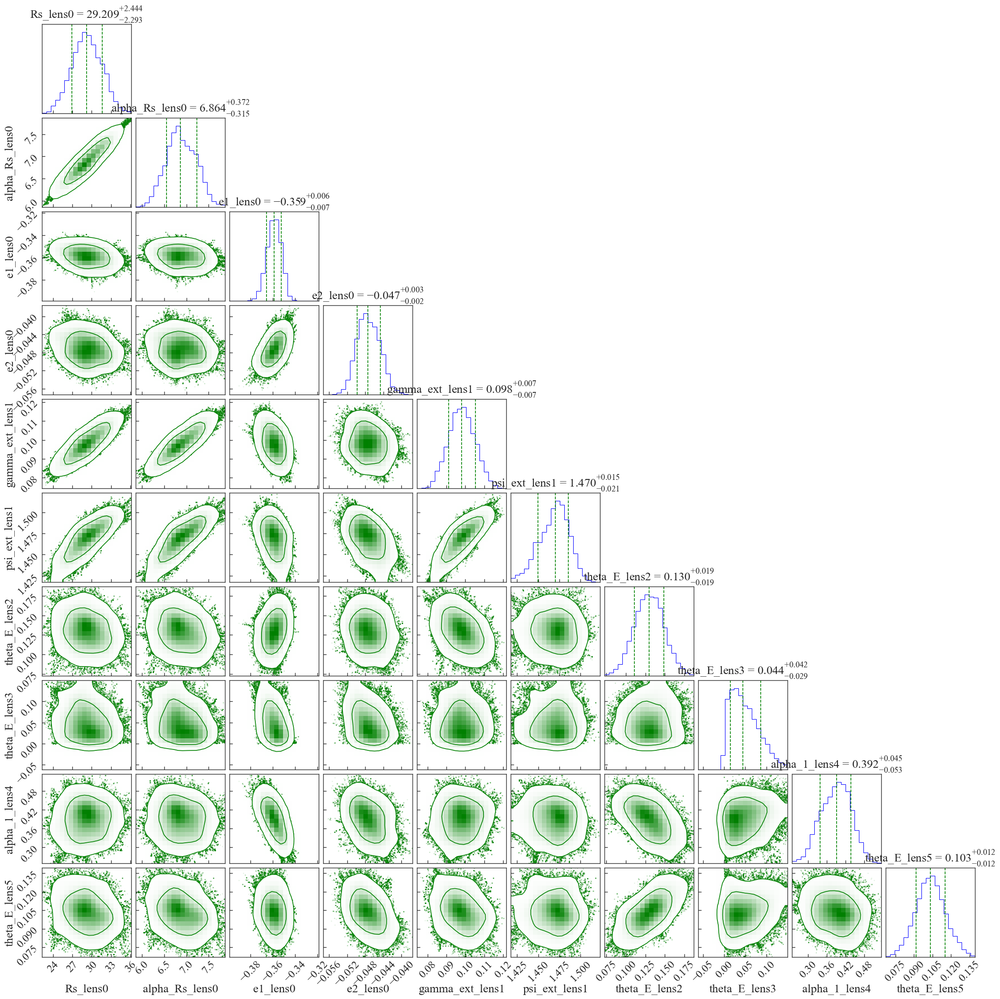

In [91]:
# Your MCMC sample
sample = samples_mcmc[burnin_steps:, :10]  # Last part of the sample, excluding burn-in
col_name = param_mcmc[:10]           # Parameter names

# Set a fixed range around the median for each parameter (e.g., +/- 3 standard deviations or other range)
range_width = 3  # Adjust this value as needed for the width around the median
ranges = [
    (medians[i] - range_width * np.std(sample[:, i]), medians[i] + range_width * np.std(sample[:, i]))
    for i in range(sample.shape[1])
]

# Create the corner plot with the customized ranges
figure = corner.corner(
    sample,
    color='green',
    labels=col_name,
    title_quantiles=[0.16, 0.5, 0.84],
    title_fmt=".3f",
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True,
    smooth=1,  # Adjust smoothing as needed
    #bins=20,
    range=ranges,  # Use custom ranges centered around the medians
    ##plot_density=True,
    levels=[0.68, 0.95], #
    #contour_kwargs={"colors": "orange"},
    hist_kwargs={"color": "blue"},  # Set color of the histograms
    hist_bin_factor=1
)


[29.20878462  6.86411564  0.12986691  0.04426483  0.39164087  0.10332997
  0.95300055]
['$R_s $', '$\\alpha_{R_s}$', '$\\theta_{E, gal1}$', '$\\theta_{E, src1} $', '$M/L $', '$\\theta_{E, gal2} $', '$\\beta_{12}$']


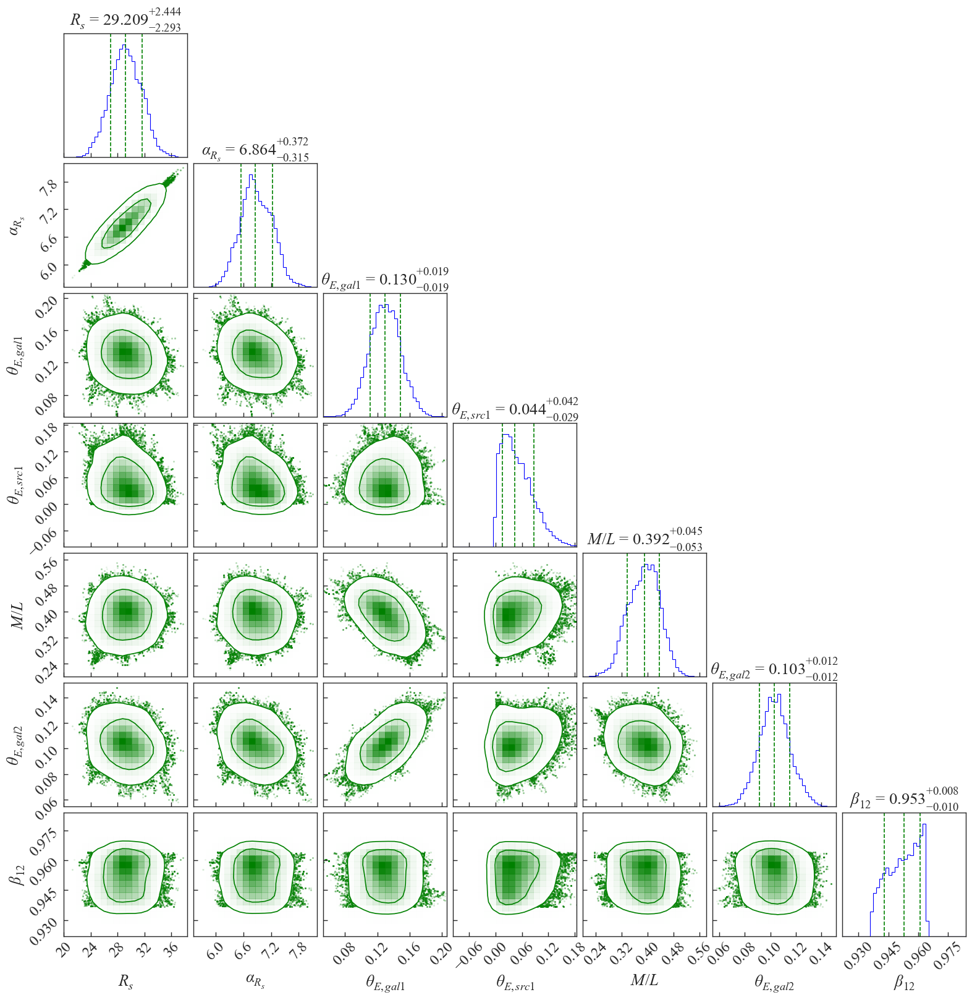

In [92]:
# Slice
beta_sample=samples_mcmc[burnin_steps:, -1:]*beta #factor*fiducial_value

sample1 = np.hstack((samples_mcmc[burnin_steps:, :2],samples_mcmc[burnin_steps:, 6:10],  beta*samples_mcmc[burnin_steps:, -1:] ))
col_name1 = param_mcmc[:2] +param_mcmc[6:10] + param_mcmc[-1:] # Combine parameter names
medians1 = np.concatenate([medians[:2], medians[6:10], beta*medians[-1:]])

print(medians1)

col_name2=[r"$R_s $",r"$\alpha_{R_s}$",r"$\theta_{E, gal1}$",r"$\theta_{E, src1} $",r"$M/L $",
           r"$\theta_{E, gal2} $",r"$\beta_{12}$"]

print(col_name2)
# Set a fixed range around the median for each parameter
range_width = 4  # Adjust this as needed
ranges = [
    (medians1[i] - range_width * np.std(sample1[:, i]), medians1[i] + range_width * np.std(sample1[:, i]))
    for i in range(sample1.shape[1])
]

# Create the corner plot
figure = corner.corner(
    sample1,
    color='green',
    labels=col_name2,
    title_quantiles=[0.16, 0.5, 0.84],
    title_fmt=".3f",
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True,
    smooth=1,
    range=ranges,  # Custom ranges
    levels=[0.68, 0.95],
    hist_kwargs={"color": "blue"},
    hist_bin_factor=2
)

plt.savefig(f'/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/Paper_DSPL/{job_name_out}_LensPara_Beta12_mcmc1.pdf') #, dpi=1200

#plt.savefig('/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/Paper_DSPL/composite_F140W_5_2_Dist_Ratio_3_run00_lens_beta12_mcmc.pdf') #, dpi=1200
#plt.savefig(f'/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/Paper_DSPL/{job_name_out}_lens_a1a2_mcmc.pdf', dpi=1200)


In [76]:
# Set a fixed range around the median for each parameter
range_width = 3  # Adjust this as needed
ranges = [
    (medians[i] - range_width * np.std(sample[:, i]), medians[i] + range_width * np.std(sample[:, i]))
    for i in range(sample.shape[1])
]

# Create the corner plot
figure = corner.corner(
    sample,
    color='green',
    labels=col_name,
    title_quantiles=[0.16, 0.5, 0.84],
    title_fmt=".3f",
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True,
    smooth=0.5,
    range=ranges,  # Custom ranges
    #levels=[0.68, 0.95],
    hist_kwargs={"color": "blue"},
    hist_bin_factor=1
)

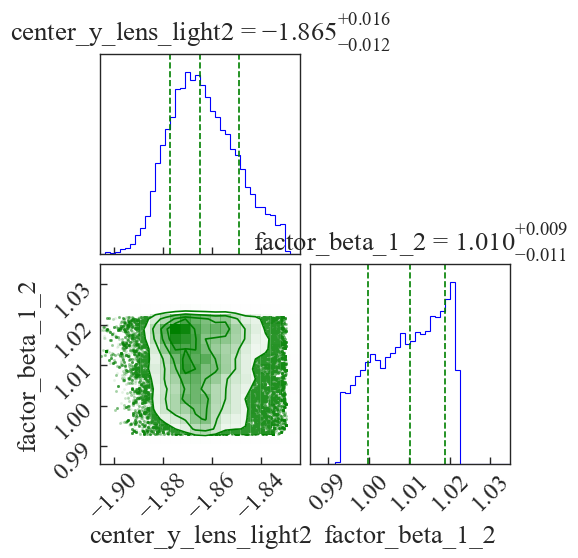

In [93]:

# Your MCMC sample
sample = samples_mcmc[burnin_steps:, n_params-2:n_params]  # Last part of the sample, excluding burn-in
col_name = param_mcmc[n_params-2:n_params]           # Parameter names

# Calculate the median for each parameter
medians2 = np.median(sample, axis=0)

# Set a fixed range around the median for each parameter (e.g., +/- 3 standard deviations or other range)
range_width = 3  # Adjust this value as needed for the width around the median
ranges = [
    (medians2[i] - range_width * np.std(sample[:, i]), medians2[i] + range_width * np.std(sample[:, i]))
    for i in range(sample.shape[1])
]

#percentile_bounds = [(np.percentile(sample[:, i], 0)*0.8, np.percentile(sample[:, i], 100)*1.2) for i in range(sample.shape[1])]


# Create the corner plot with the customized ranges
figure = corner.corner(
    sample,
    color='green',
    labels=col_name,
    title_quantiles=[0.16, 0.5, 0.84],
    title_fmt=".3f",
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True,
    smooth=0.5,  # Adjust smoothing as needed
    #bins=20,
    range=ranges,  # Use custom ranges centered around the medians
    ##plot_density=True,
    #levels=[0.68, 0.95], #
    #contour_kwargs={"colors": "orange"},
    hist_kwargs={"color": "blue"},  # Set color of the histograms
    hist_bin_factor=2
)


Removed no burn in


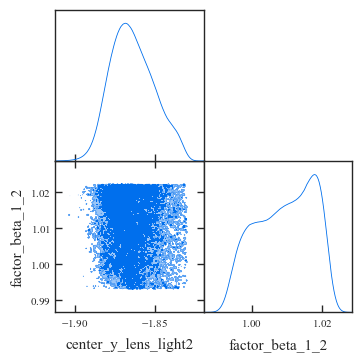

In [94]:
import getdist
from getdist import plots, MCSamples

# Triangle plot using GetDist
param_names = param_mcmc[n_params-2:n_params]
samples = samples_mcmc[burnin_steps:, n_params-2:n_params]
gdsamples = MCSamples(samples=samples, names=param_names,labels=None) #, labels=[r"$w$", r"$\Omega_m$"] ,labels=['w', 'Omega_m']
#percentile_bounds = [(np.percentile(samples[:, i], 1)*1.5, np.percentile(samples[:, i], 99)*0.5) for i in range(samples.shape[1])]

range_limits = {
    param_names[i]: (
        np.percentile(samples[:, i], 1) * 0.9,  # 0th percentile scaled by 0.9
        np.percentile(samples[:, i], 99) * 1.1  # 100th percentile scaled by 1.1
    )
    for i in range(samples.shape[1])
}


g = plots.get_subplot_plotter()
fig = plt.figure(figsize=(15, 15))
#range_limits = {'w': [-2.0, 0], 'omega_m': [0., 1]}  # Modify these ranges as needed

g.triangle_plot([gdsamples], filled=True, 
                #markers={'w': median_value_w0, 'omega_m': median_value_omega_m},
                contour_args={'alpha': 1.0},
                limits=range_limits
               )  # Apply range limits here

plt.close(fig)

In [95]:
medians

array([ 2.92087846e+01,  6.86411564e+00, -3.58852046e-01, -4.74381653e-02,
        9.80164069e-02,  1.47028077e+00,  1.29866911e-01,  4.42648286e-02,
        3.91640872e-01,  1.03329968e-01,  1.86334623e-01,  2.34053068e+00,
        2.58726052e-02, -3.16251918e-01, -1.07252744e+00,  1.06003263e+00,
        2.59353591e-02, -1.08320780e+00,  1.01129430e+00,  5.69948538e-02,
        5.38174174e-01,  4.85902233e-02,  3.15604722e-01, -1.10428203e-01,
       -3.18011310e-01, -8.00011801e-01, -4.81392010e-01,  3.22877981e-01,
        5.01787696e+00, -4.11397993e-01,  1.14478814e+00,  1.35874129e-01,
        9.63889238e-01,  4.90158606e-01,  2.34313152e-01, -7.10352762e-01,
       -1.86490500e+00,  1.01030708e+00])

[29.20878462  6.86411564  0.39164087  0.12986691  0.10332997  0.04426483
  0.95300055]
Shape of sample1: (304000, 7)
Shape of medians1: (7,)
Length of col_name2: 7
['$R_s $', '$\\alpha_{R_s}$', '$M/L $', '$\\theta_{E, gal1}$', '$\\theta_{E, gal2} $', '$\\theta_{E, src1} $', '$\\beta_{12}$']


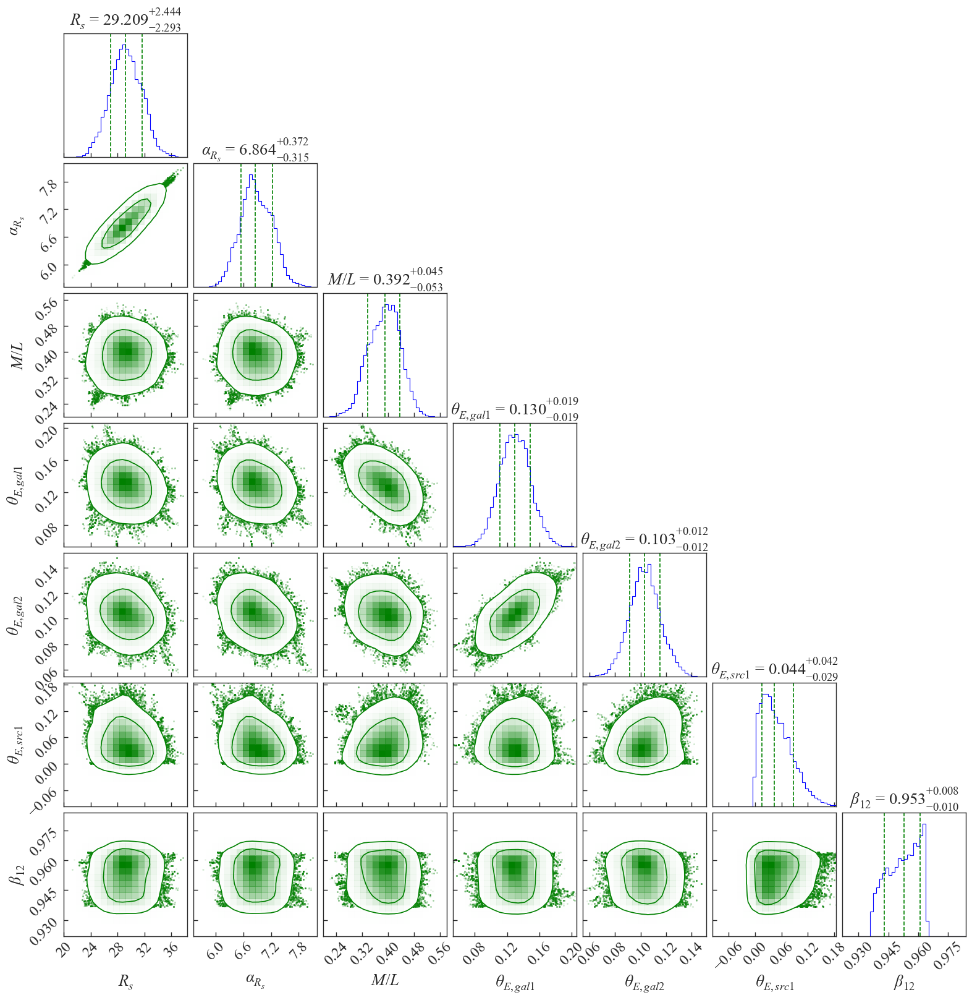

In [ ]:
# Slice
beta_sample=samples_mcmc[burnin_steps:, -1:]*beta #factor*fiducial_value

sample1 = np.hstack((samples_mcmc[burnin_steps:, :2], samples_mcmc[burnin_steps:, 8:9], samples_mcmc[burnin_steps:, 6:7],
                     samples_mcmc[burnin_steps:, 9:10], samples_mcmc[burnin_steps:, 7:8],  beta*samples_mcmc[burnin_steps:, -1:] ))
col_name1 = param_mcmc[:2]+ param_mcmc[8:9]+ param_mcmc[6:7]+ param_mcmc[9:10] + param_mcmc[7:8] + param_mcmc[-1:] # Combine parameter names
medians1 = np.concatenate([medians[:2], medians[8:9], medians[6:7], medians[9:10], medians[7:8], beta*medians[-1:]])

print(medians1)
print("Shape of sample1:", sample1.shape)
print("Shape of medians1:", medians1.shape)
print("Length of col_name2:", len(col_name2))

col_name2=[r"$R_s $",r"$\alpha_{R_s}$",r"$M/L $", r"$\theta_{E, gal1}$",
           r"$\theta_{E, gal2} $", r"$\theta_{E, src1} $", r"$\beta_{12}$"]

print(col_name2)
# Set a fixed range around the median for each parameter
range_width = 4  # Adjust this as needed
ranges = [
    (medians1[i] - range_width * np.std(sample1[:, i]), medians1[i] + range_width * np.std(sample1[:, i]))
    for i in range(sample1.shape[1])
]

# Create the corner plot
figure = corner.corner(
    sample1,
    color='green',
    labels=col_name2,
    title_quantiles=[0.16, 0.5, 0.84],
    title_fmt=".3f",
    quantiles=[0.16, 0.5, 0.84],
    show_titles=True,
    smooth=1,
    range=ranges,  # Custom ranges
    levels=[0.68, 0.95],
    hist_kwargs={"color": "blue"},
    hist_bin_factor=2
)

plt.savefig(f'/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/Paper_DSPL/{job_name_out}_LensPara_Beta12_mcmc2.pdf') #, dpi=1200

In [169]:
ranges

[(19.997675396818018, 38.4198938529141),
 (5.526961957581139, 8.201269318068498),
 (0.20130151244834157, 0.5819802324015751),
 (0.05336969799640519, 0.20636412381487823),
 (0.0550876078706699, 0.15157232891726688),
 (-0.09642657674956487, 0.18495623395559832),
 (0.9219793633077618, 0.984021727722445)]

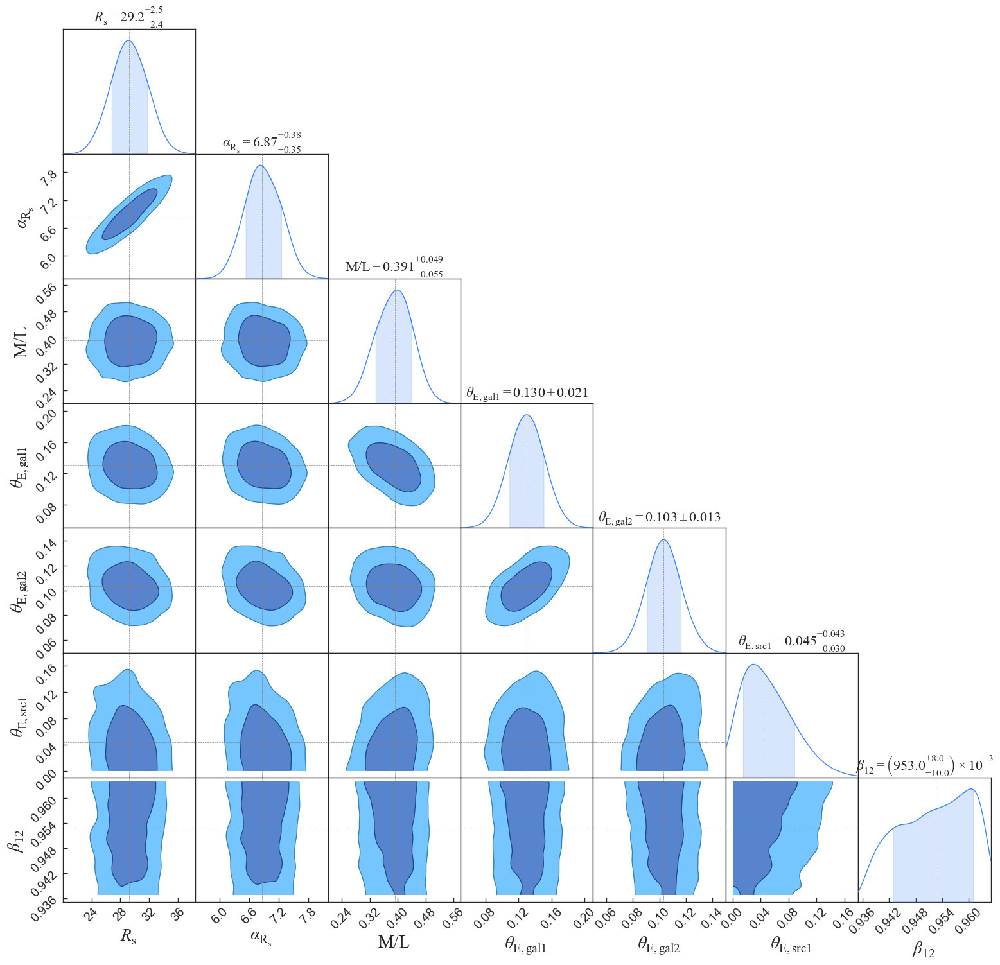

In [226]:
from chainconsumer import Chain, ChainConsumer, ChainConfig, PlotConfig,Truth 
import pandas as pd
#from chainconsumer import Chain, ChainConsumer, make_sample
col_name3 = [
    r"$R_{\mathrm{s}}$",
    r"$\alpha_{\mathrm{R_{s}}}$",
    r"$\mathrm{M/L}$",
    r"$\theta_{\mathrm{E,gal1}}$",
    r"$\theta_{\mathrm{E,gal2}}$",
    r"$\theta_{\mathrm{E,src1}}$",
    r"$\beta_{\mathrm{12}}$"
]

# Convert numpy array to pandas DataFrame
df1 = pd.DataFrame(sample1, columns=col_name3)

parameter_ranges = {
    df1.columns.tolist()[0]: (20, 38.4),
    df1.columns.tolist()[1]: (5.5, 8.2),
    df1.columns.tolist()[2]: (0.2, 0.58),
    df1.columns.tolist()[3]: (0.05, 0.21),
    df1.columns.tolist()[4]: (0.05, 0.15),
    df1.columns.tolist()[5]: (-0.01, 0.18),
    df1.columns.tolist()[6]: (0.935, 0.965)
}


# Create ChainConsumer object
c = ChainConsumer()

# Add your chain
c.add_chain(Chain(samples=df1,name="MCMC Chain",statistics="cumulative", smooth=10,bins=10,
                  shade_alpha=0.8
                ) ) #, name="MCMC Chain" kde=0.5,
#extents=parameter_ranges,truth=medians1,  location=medians1
#smooth=np.sqrt(sample1.shape[0]/1000)  

# Create the plot
c.set_plot_config(PlotConfig(extents=parameter_ranges,label_font_size=20,tick_font_size=14, summary_font_size=16,dpi=400))
#c.add_truth(Truth(medians1))
c.add_truth(Truth(location={df1.columns.tolist()[0]: medians1[0], 
                            df1.columns.tolist()[1]: medians1[1],
                            df1.columns.tolist()[2]: medians1[2],
                            df1.columns.tolist()[3]: medians1[3],
                            df1.columns.tolist()[4]: medians1[4],
                            df1.columns.tolist()[5]: medians1[5],
                            df1.columns.tolist()[6]: medians1[6]}, line_style="--", line_width=0.5,color="gray"))

fig = c.plotter.plot( )

# Customize the plot appearance
#plt.tight_layout()

# Save the plot if needed
plt.savefig(f'/Users/nandinisahu/Library/CloudStorage/OneDrive-UNSW/AGEL/Paper_DSPL/{job_name_out}_mcmc_cumulative2.pdf') #, dpi=1200

In [208]:
medians1[0]

29.20878462486606

In [149]:
sample1.shape

(304000, 7)

In [150]:
np.cbrt(304000)

67.23950813597926